### Introduction to Authentication and API Gateway

I'll first go over all the different methods related to access control, authentication and authorization on API Gateway. Then I will dive deeper in each of those methods.   
  
An advantage of having API Gateway to do the authentication and authorization is that if someone that isn't authorized to access your application makes a request, your backend, which is behind API Gateway, will never see that request. Thus, the advantage here is that API Gateway is protecting your backend.  
  
As you learned, there are 2 main types of APIs in API Gateway. There are REST API and there are HTTP API.    
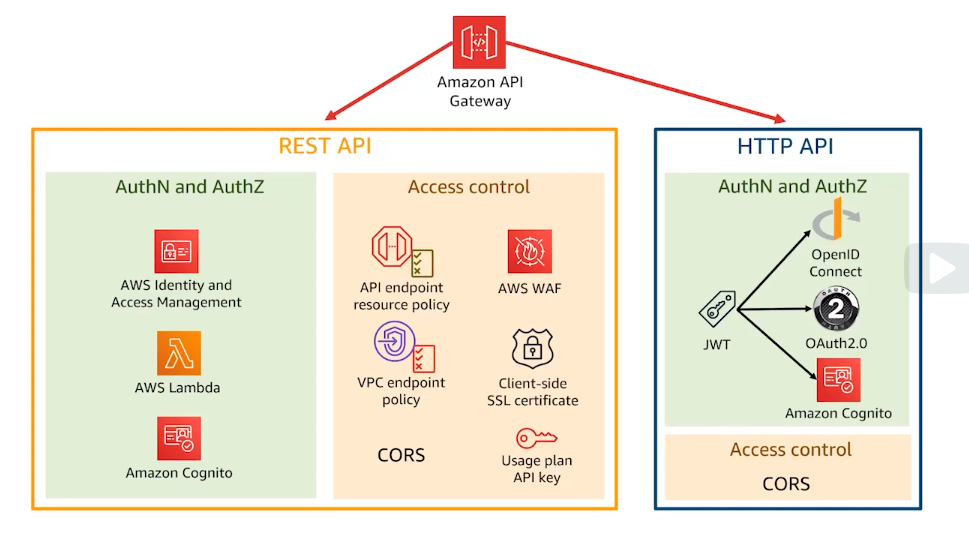
  
For the REST API type, the mechanism for API Gateway to do authentication and authorization are Identity and Access Management, AWS authorizers and Amazon Cognito user pools. There are a few other mechanisms related to access control around this type of API.
Those are the resource policies applied at an API Gateway endpoint, endpoint policies for interface VPC endpoint, cross-origin resource sharing or CORS, AWS WAF, a web application firewall, client-side SSL certificate, and usage plans with API keys.  
  
For HTTP APIs, the only way to do authentication and authorization is by using JSON Web Tokens or JWT, that are part of the OpenID Connect and OAuth 2.0 protocols. This means that you can integrate with any third-party identity providers. Also, because Amazon Cognito User Pools uses JWT as well, it means that it's also a supported method of authentication.  
  
To be able to further restrict certain routes to privileged users, you can use authorization scopes. For example, you may have GET/dragons that you want anyone authenticated to be able to hit, but for a POST/dragon, you may only want to allow this action
to certain individuals, hence the use of scope in the access token returned by an OAuth 2.0 identity provider. In that identity provider, you make use of custom scopes, think of those as strings like admin. Then on the POST/dragon within API Gateway, you can verify that this special admin string actually exists. And then you'll allow the user in.   
  
In terms of access controls for HTTP API, it supports cross-origin resource sharing like REST API. However, that's it for HTTP APIs. It may not seem much, but OpenID Connect and OAuth2.0 are open standards on which you can find a ton of information on the internet. 
  
What I would like to do now is go over all those different types of mechanisms for REST APIs.  
  
First, we will go through the access control types.  
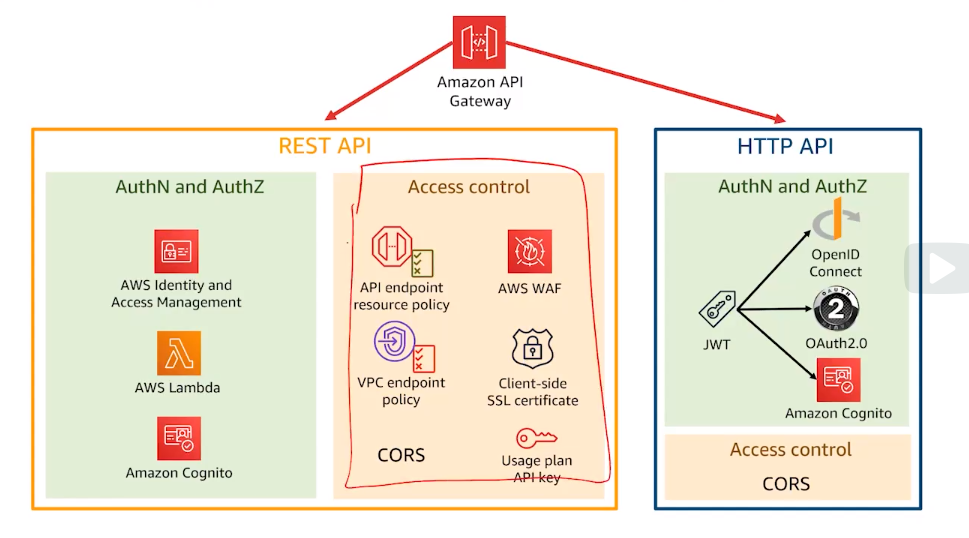
  
Then I will go into those specific mechanisms that are really for authentication and authorization.  
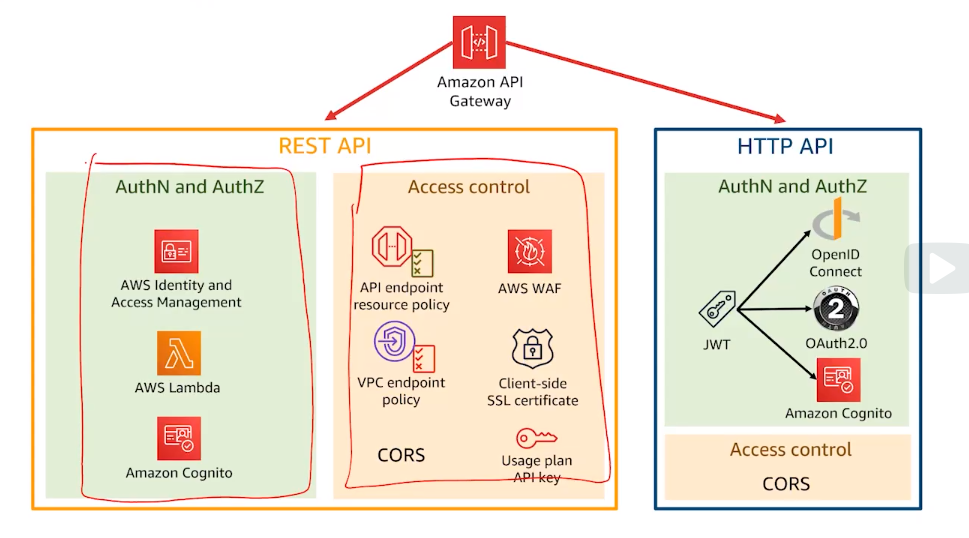
  
Finally, I will leave Amazon Cognito on its own so I'll do a full-view just on that. Because it's a completely different beast.  
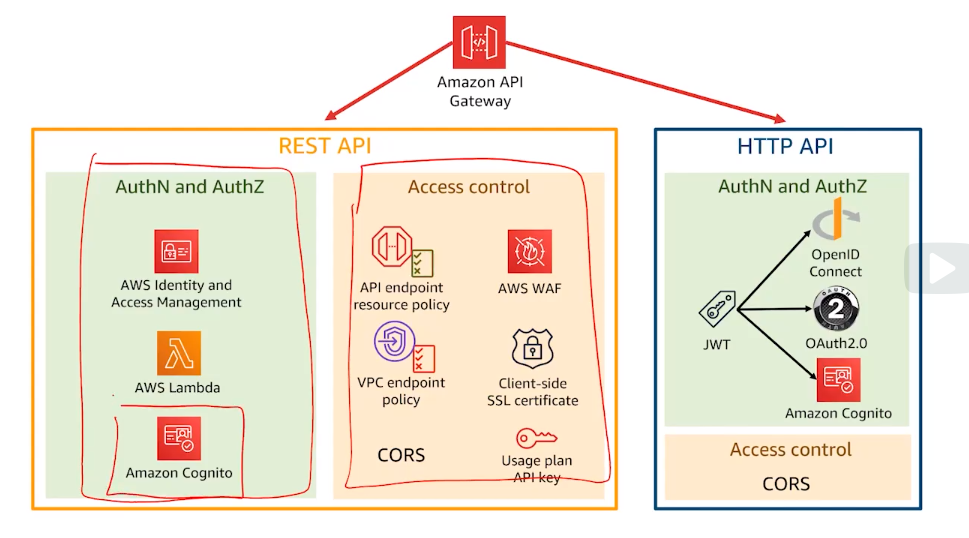

<pre>

    
</pre>
### API Gateway Access Controls

I want to go through the different types of access control mechanisms for API Gateway.  
  
First, these access controls can act as an addition to the authentication and authorization mechanisms.  
  
So these two together.  
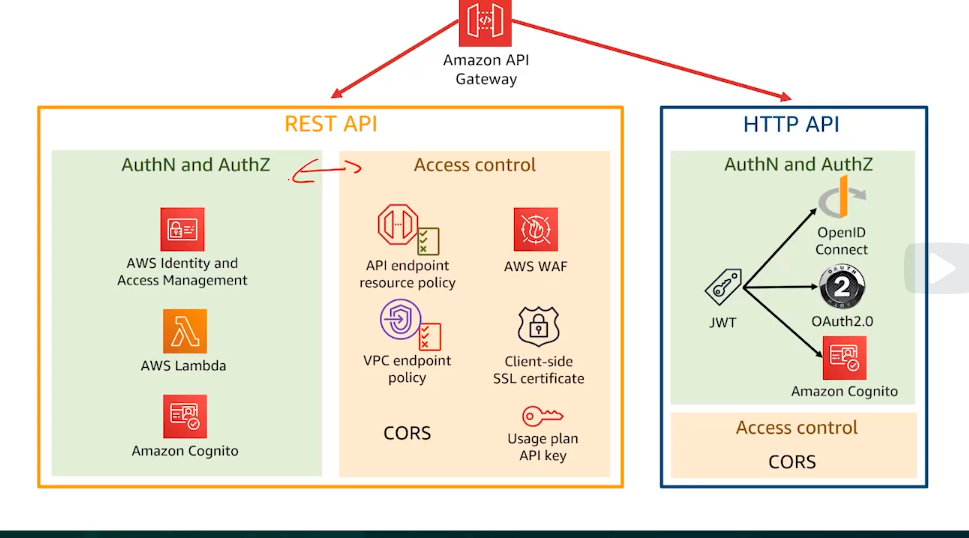
  
You can use these access controls on top of IAM, AWS Lambda authorizers, and Amazon Cognito user pools. This means that you don't have to choose between these two. In fact, you can even combine multiple access controls as well.  
  
Now, let's start with a major difference between one of those.
All mechanisms of access control - except one - are client-side where the request from the client comes in. It is to prevent or allow the access in. On the server-side, the only mechanism there is the Client-side SSL certificate. This is a mechanism to authenticate API Gateway itself to your backend. This way, your backend is sure that it is your API, an API Gateway, that's connecting to it. You would use this only if you wanted to authenticate API Gateway from your backend.  
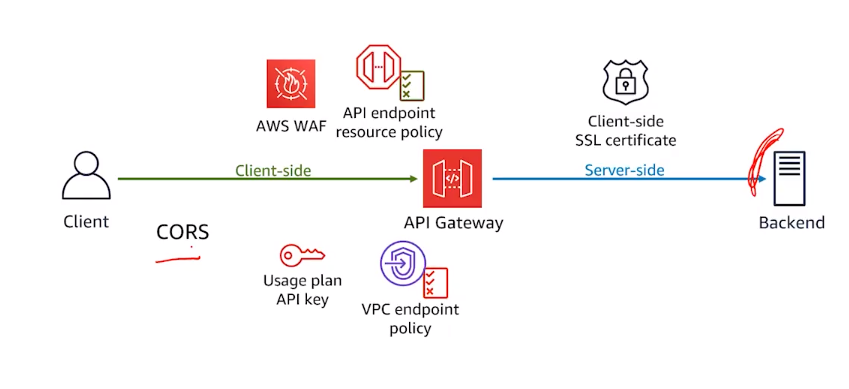
  
Okay, now that we took care of the backend, let's talk about all those client-side mechanisms.   
  
First, let's talk about CORS: "cross-origin resource sharing" is a browser security feature that restricts cross-origin HTTP requests that are running in the browser, like the one that you can see here.  
For example, if the website of your application was www.example.com, and your API endpoint was dragons.api.com, your users will enter www.example.com in their browser to access your application. Then if you had some Javascript that was executing as part of the clients browser, and that was going to dragons.example.com to fetch some data from your API, right? That will mean that the script will make a cross-origin HTTP request to dragons.example.com.   
What cross-origin means here is that the origin or domain in the URL is different than the origin or domain inside of the script,
as you can see here. The CORS browser security feature will now get involved to make sure that this isn't something malicious. The browser wants to know if it is alright to connect to dragons.example.com when coming from the original URL, www.example.com. To do so, it will look at some headers or make additional requests using the options method depending on the type of method being used;get, post, head, etc. So by using and setting up CORS on your API Gateway, like so, you can ensure that only the clients coming from www.example.com, right, as their origin, that are all allowed to query for your dragons.example.com API.  
  
In most cases, where the browser of a client will be involved in making a request to API Gateway, you will need to configure CORS.
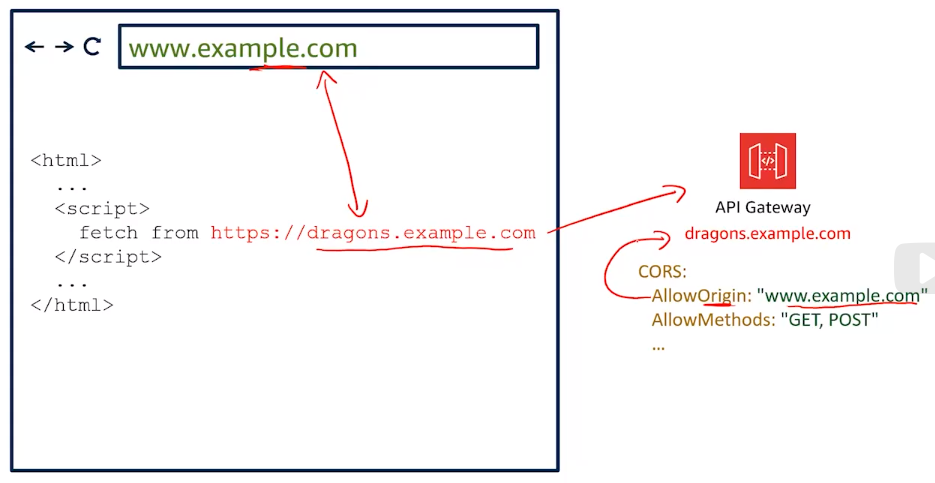


<pre>




    
</pre>
The next mechanism related to access control is the AWS service called AWS WAF, which is a web application firewall that can be used to protect your API from common web exploits. You can use the managed rules for WAF to address issues like OWASP top 10 security risks which are regularly updated as new issues emerge. It can also be configured to filter traffic based on rules that you define. For example, you can filter any part of the web request, such as IP addresses, HTTP headers, HTTP body, or URI strings. It's always a good idea to have a web application firewall in front of your web applications.   


<pre>



</pre>
The third mechanism that's related to limiting the access to authorize clients is usage plans. To use it, you first need to create an API key in API Gateway. You then must send this key to a client. This key is a string made up of alphanumerical characters. When a client wants to send a request, it inserts this API key as the value of the HTTP header x-api-key. As you can imagine, using this solely for the purpose of authentication isn't a great idea, as it's in clear text in the request, and the client must know about it. So why would you want to use this? Well, it goes with usage plans, which you can add to an API key
to allow customers to access selected APIs at agreed upon request rates and quotas.  
  
Like the example here,  
  
where I have added a quota of 100 requests per month and a throttling of 10 requests per second. This mechanism is if you want to apply some throttling or quotas to your REST API per client. 
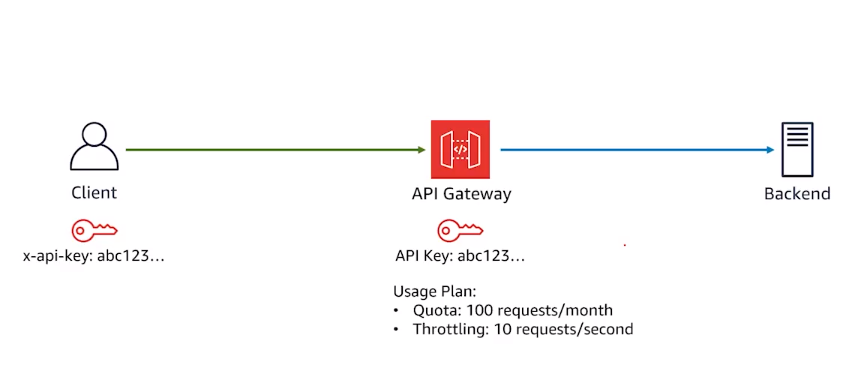

<pre>


    
</pre>
Resource policies is the next mechanism I want to discuss here.   
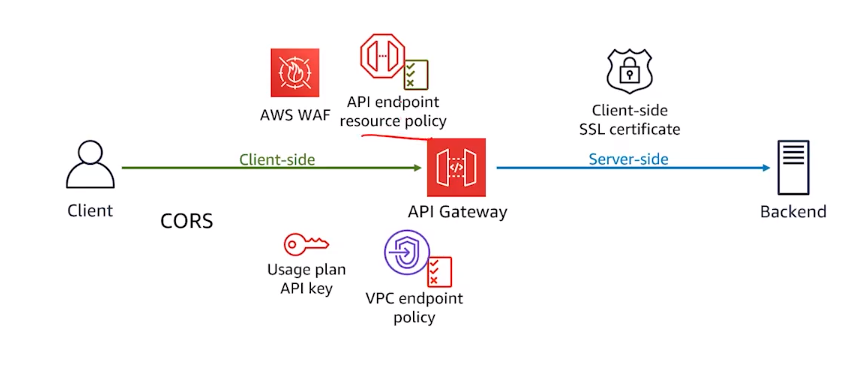
  
A few AWS services have this capability, like the Simple Storage Service, or S3. It allows you to create resource-based policies
to allow or deny access to your APIs, and methods, using IAM conditions elements. These includes users from a specific AWS account, a specific source IP address range, or a specific Virtual Private Cloud or VPC endpoint.  

Let's look at an example in my browser.

I'm currently in the API Gateway console on the dragons API

I will click on the resource policy that I have, and I've already created one right here. It says that I'm allowing everyone to invoke the GET/dragons. Okay, and I'm also allowing everyone again to invoke POST/dragons but only if you come from this IP address, so it's not everything everyone here. So you can see that I can go pretty deep and pretty specific inside of that policy.

One important thing to note here is that even though there are no deny statements in this resource policy, there is actually an implicit deny. For example, if a client with the IP address 1.2.3.4 was coming in and sending a request to do a post on /dragons, it will actually be denied because it's not that IP address, right? It's not equal to that. So it will hit the implicit deny.  
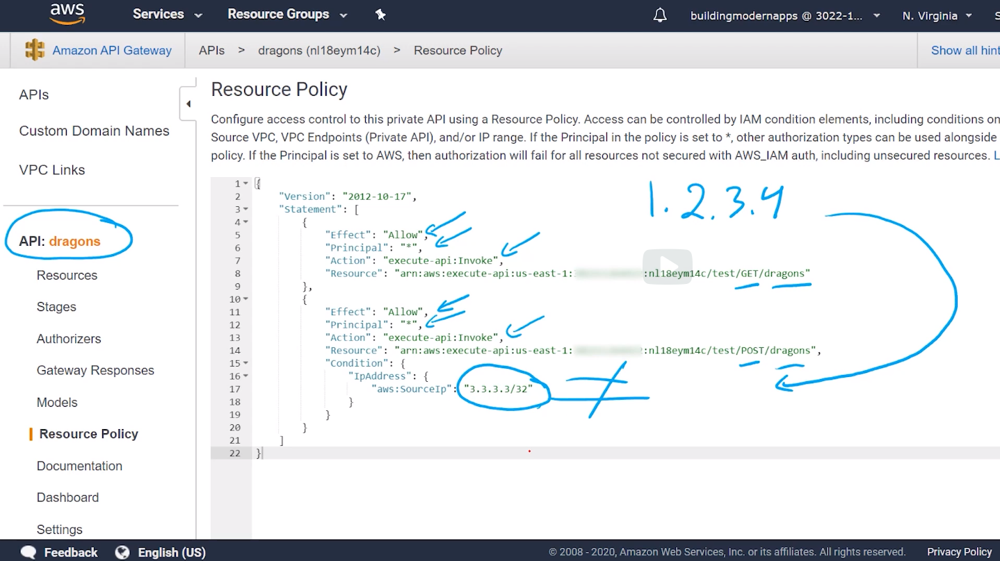
  
That impulsive deny only applies when you add a resource policy though. Adding one of those policies can complicate the authorization flow if you have other authorizers. When resource policies are combined with IAM, Lambda authorizers, and Cognito,
they work together.  
Resource policy can use the users identity that was authenticated with those three authorizers in the definition of the policy.
This allows you to create some pretty specific resource policy.  
However, the authorization flow changes based on the type of authorizer you use. I will leave some great flow diagrams
that explains how these works depending on your type of authorizer in the resources for this week.  
  
The resource policy access control mechanism is great for cross AWS account access and applying more restrictions to the other authorizers, It's also great for limiting access only to certain ranges of IP addresses.   
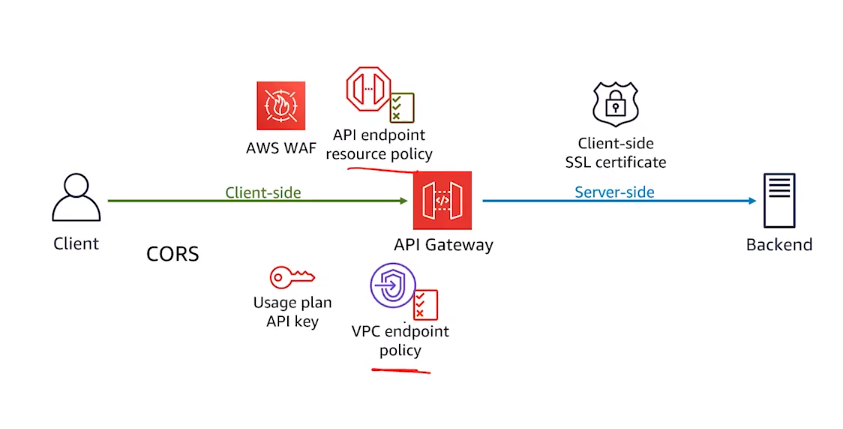
  

<pre>


    
</pre>
The last access control mechanism I want to discuss is endpoint policies for interface endpoints. As you learned, you can create a private API that is only reachable from inside of your Virtual Private Cloud or VPC. To access this private API from let's say,
an EC2 instance inside the VPC. You must use a VPC interface endpoint. Interface endpoints are powered by AWS PrivateLink
of technology that enables you to privately access AWS services by using private IP addresses. Thus, keeping the traffic entirely within AWS and not exposing your API to the internet at all. On those endpoints, you can add a policy to improve the security
of your private APIs. It can restrict the traffic by allowing or denying access to specific private APIs. This type of policy is only for private APIs, though. So if you're using a public API, or of type edge, or regional, you don't need to think about
this mechanism of access control at all. In this section, I covered six different mechanism for controlling and managing access 
to a REST API in API Gateway;  client-side SSL certificates, CORS, AWS WAF, usage plans with API keys, resource policies, and endpoint policies for interface endpoints.

<pre>




    
</pre>
### API Gateway Authentication and Authorization

Let me introduce you, to the three authentication and authorization mechanisms, that can be added as an authorizer. Those are, IAM, Lamda authorizers, and Cognito. 
It's very simple to set some of those authorizers, so let's go into the console, to see what it looks like.
  
I'm currently in the API Gateway console, on the dragons API that was created earlier. Under resources, I can select the desired method, of execution to which I would like to add an authorization. What this means, is that you can pick an authorization type,
that's different per method of execution. For example, you could keep GET/dragons, without authorization, so public, but then add authorizations for POST/dragons. So let me add that there.
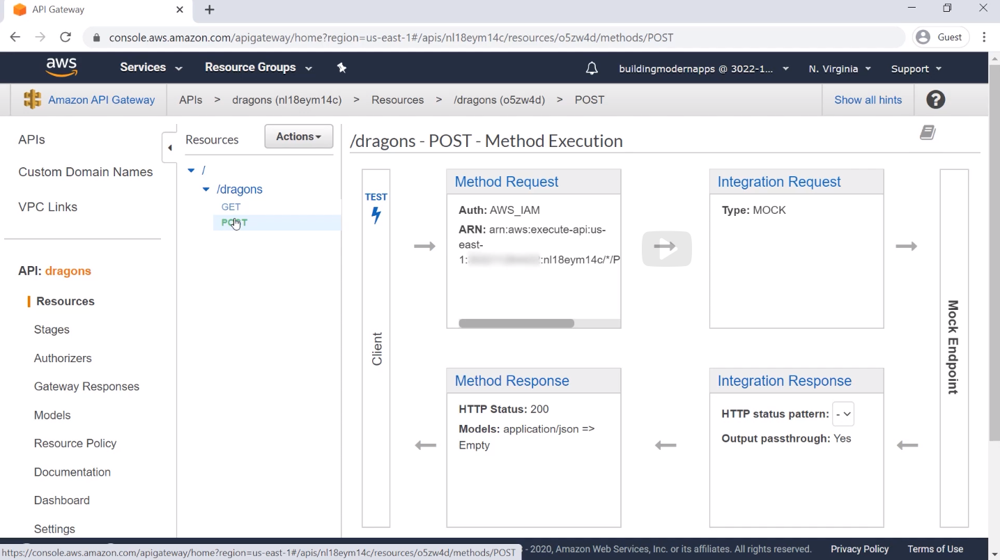
  
Since authorization is the first step, that API Gateway shall process when receiving a request, the authorizer option is in the first box here, after the client called, Method Request.
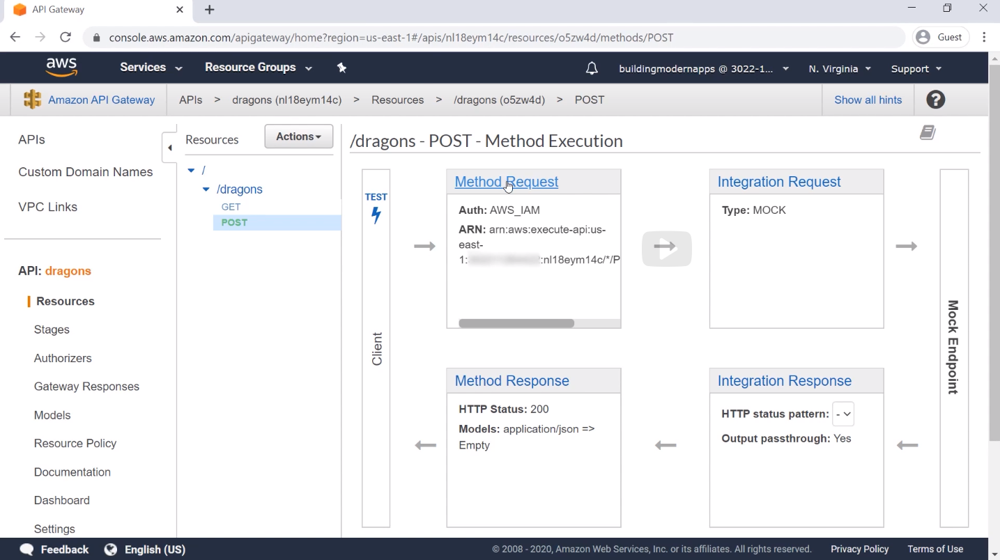
  
I can now select the appropriate authorization. In this case, only AWS IAM is available, as we haven't created any Lambda, or Cognito User Pool authorizers yet. 
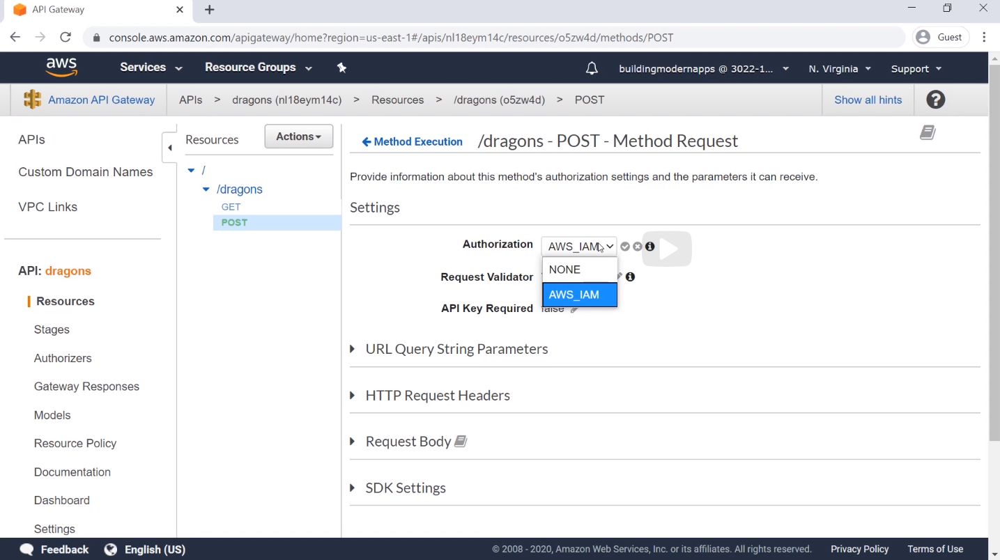
  
Let's talk about AWS IAM first. This authorizer, adds the same authentication, and authorization on top of your API, that is available in front of any AWS service. This is done via an access key and a secret key, using the Signature Version 4 protocol.
  
Although it's great to understand how an access key, and secret key are used to generate a signature, each time a request is sent to AWS, you will probably never have to do it. That's, because the AWS SDK does this for you. But what about an API that you create in API Gateway. Although you can use the AWS SDK to manage the API, like, creating it and updating it, you can't use the AWS SDK, for invocating, that API. And that's where I want to introduce you to the SDK, that you can generate for your API. You do that by going under Stages, and clicking on the Stage that was already created, called, test.
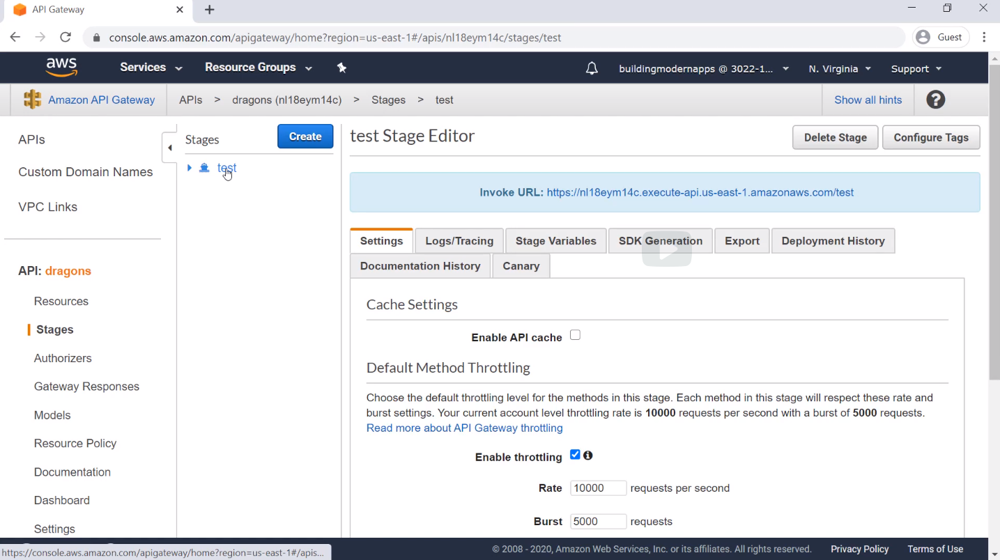
  
Under the SDK Generation tab, I can generate one for each of the platforms that you see here. This SDK makes things way easier to invoke the API, as doing the POST/dragons just becomes a function call. The SDK contains the libraries to make the HTTP call, and it will do the signature of that request for you. 
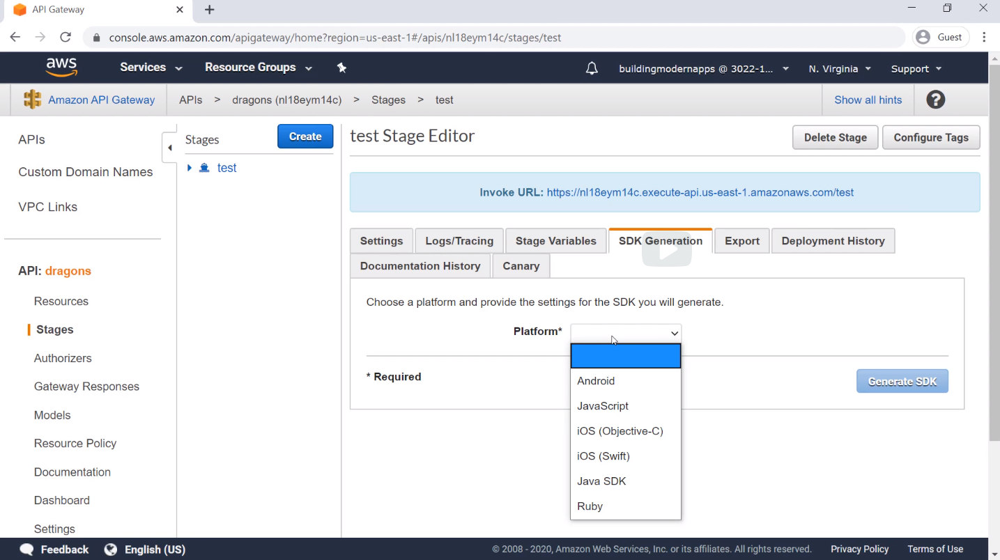
  
This authorization type is typically used, for server to server communication. For example, if your code was running in a container, in Elastic Container Service or, on an EC2 instance, and it was making a call to your API, then you should authenticate and authorize it via IAM, the same way, as if your code was to make a call, to a service of AWS like S3. The best practice here will be to attach an IAM role, to those services, and use the temporary credentials, generated and rotated via this IAM role, for your code to get authenticated. The authorization will be made via the IAM policy, attached to that IAM role. In that policy, you can go as specific as saying that, the credentials allow access to one specific method, and one specific stage. So pretty deep.  
Like I mentioned, IAM, as an authorizer for your API, is made to use for server to server communication. Your code running in AWS, speaking to API Gateway, and communicating with your server backend. To use the other two authorizers, you will need to configure the service itself first. For example, you will configure, a new Cognito User Pool first, then, you will configure an authorizer in API Gateway, by clicking under authorizers here on the left side menu. Then, you will click on Create New Authorizer, and here you can see the other two options of Lambda, and Cognito. From here, I can now select the Cognito User Pool,
that I have already created, which is called demo.
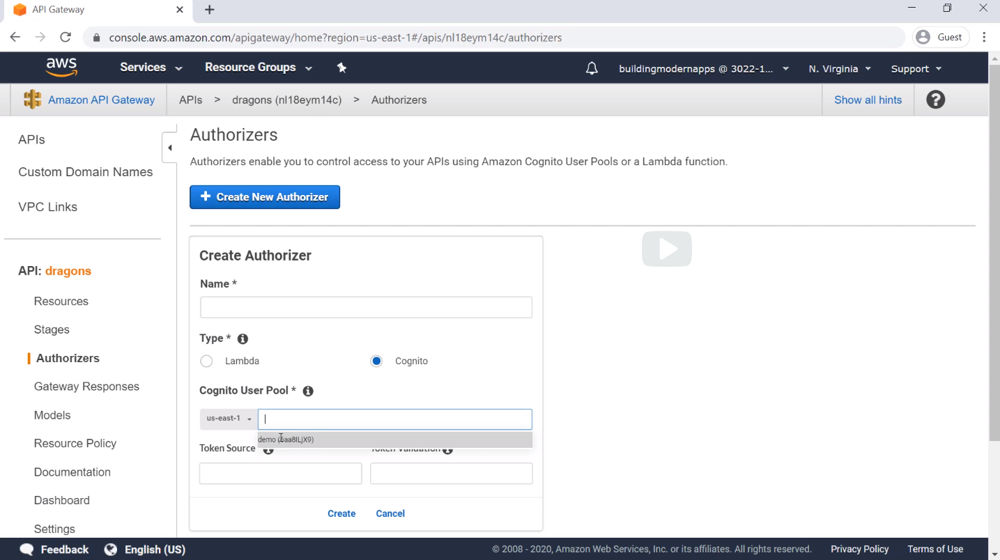
  
Then, I will be able to reference this authorizer, in my POST/dragons authorizer.  
  
  
This second type of authorizer called Cognito User Pool, is a user directory. You can use this service, to have users sign up and sign in. Once the user is signed in with Cognito, the application will receive a JSON Web Token, that can then be sent to API Gateway, via the authorization header. I will go in details on how Cognito works later. You will use this kind of authentication for a web, or a mobile application, to authenticate to API Gateway.   
  
At this point, we covered two different types of clients.  
* First, servers making calls to API Gateway, using IAM as the authorizer.
* Second, web and mobile applications acting as the client where you should use Cognito User Pool to authorize them.
  
So, what could we possibly need now? Customization and flexibility.  
What if these authorizers are missing a feature you want? Maybe you want to authenticate via custom authorizer, like LDAP. That's where Lambda authorizers come into play. These ones right there.
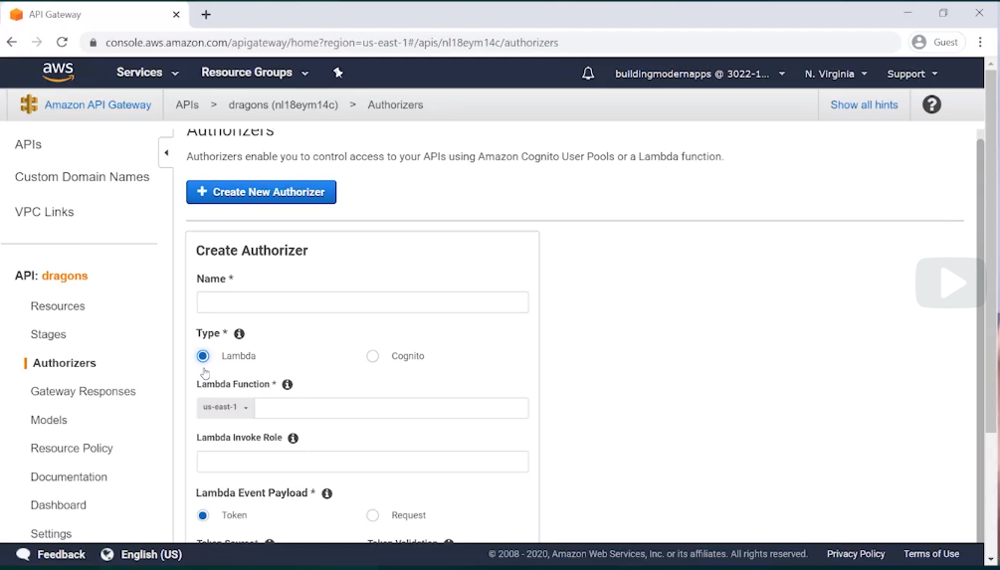
  
<b>It provides the greatest flexibility, but it comes with a price, you will have to code it.</b>  
What this authorizer allows you to do, is call a piece of code that is executed, whenever a request is made. This means, that you can integrate with any authentication tools that you want, as you are responsible for coding the authorizer. We will discuss Lambda later. But I would like to, for you to understand, how the flow with this authorizer, actually works.  
Let me show you an example.  
Here, I have a client that wants to go through API Gateway, to access a backend. I also created my authorization code using AWS Lambda. The flow will look like this, first, the client will send a request with some parameters, those parameters could be a token, username password, or anything that is required to authenticate them. Also, before doing anything else, you could have API Gateway user regular expression to validate the format of those parameters, so that it won't even execute your autorization code,
before making sure the request is valid. These requests parameters will then be sent, to my authorization code in Lambda. That code can do whatever it wants, using those authentication parameters. Maybe it could call an OAuth 2.0, or SAML identity provider,
or maybe it will call LDAP or Active Directory. Then, no matter if the user is authorized or not, that code needs to return
a principal and a policy. The principal is the definition of this user. Maybe it's a username, or user ID, or anything that identifies this client uniquely. The policy, is like an IAM policy it defines what the user is allowed to do, and not. The code, isn't the one allowing or denying the access, it's only providing that policy which defines what the user can do. Then, this policy is going to be evaluated, and it will be cached. This is useful, so that the subsequent request, don't need to go through the authorization code again. It can just be evaluated, right away. Now, depending on, if the policy says, that the client is allowed. If it does, then it will be sent to the backend as allowed. If the policy says that it is denied, then the client will be sent a 403 response code, which means, forbidden. And that's it.
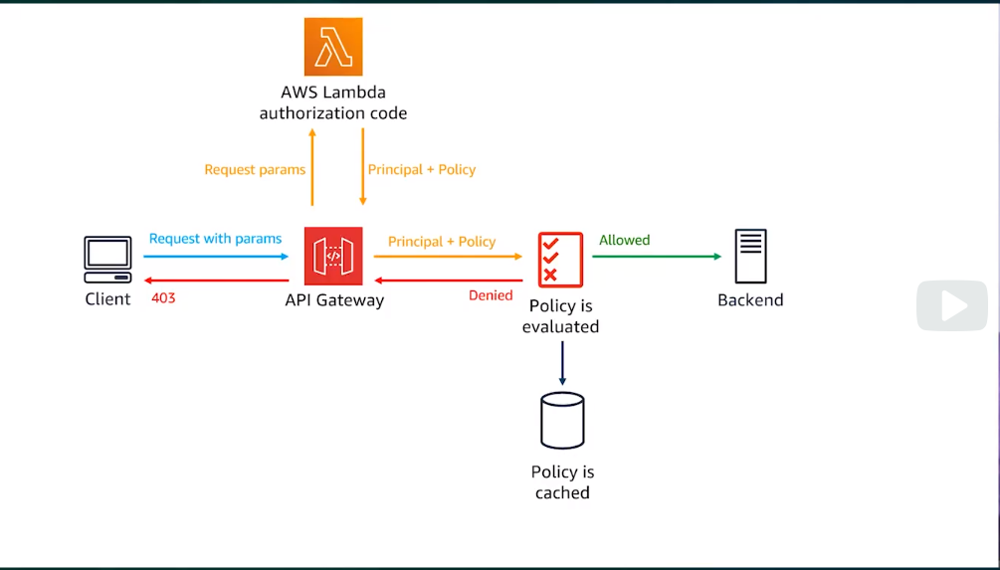
  
Lambda Authorizers, is used in the case, where you need more flexibility, than what IAM and Cognito can provide. However, remember that it's not as simple as just selecting an option from a drop down. You do have to code. There you have it. IAM, Lambda, and Cognito, are your three available options for authentication, and authorization for REST APIs.

<pre>


    
</pre>
### Introduction to Amazon Cognito

Previously, I mentioned that one of the options to do it to authentication and authorization, is Amazon Cognito user pool.
The reason why I mentioned user pool, is because Amazon Cognito service is made up of two services.   
User pool and Federated Identities or identity pool. Same thing.  
Although those two services can work together, it's important to understand their distinction between them, and that they also work individually.  
Let's start with Cognito user pools.   
This service is a user directory, which you can also refer to as an identity provider. It allows you to sign up users with email or phone number validation, sign them in, help them reset their password, and even ask them to do multifactor authentication. To make things even easier, user pool also has an option for a hosted user interface. So instead of having to create your own web page for asking your users for their username and password, AWS already created web pages for this workflow, which you can customize and AWS will host it for you. Once the user is logged in, you can directly authenticate with certain services like API Gateway.  
Let's look at a workflow for this integration.  
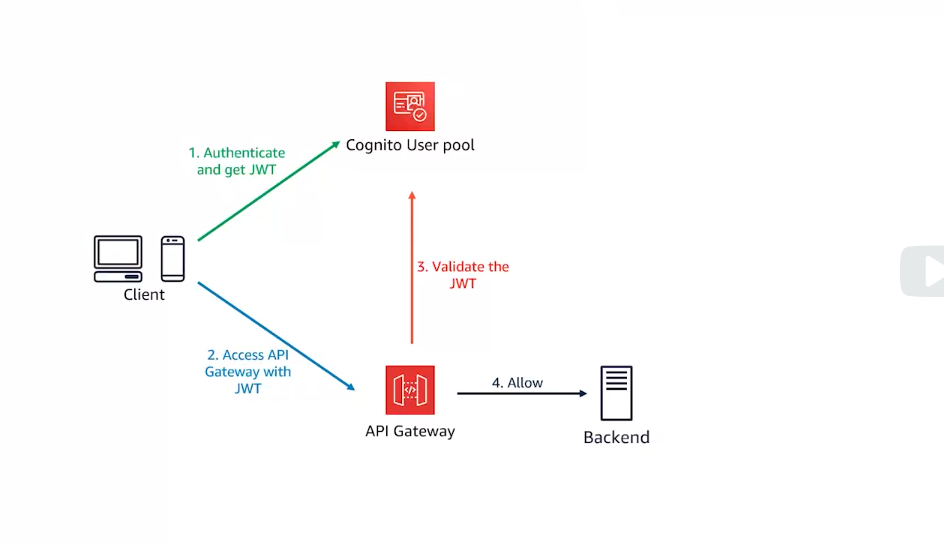
  
The first step is that the client needs to authenticate to Amazon Cognito user pool. That's either via sending the credentials directly, via its API or via that hosted authentication page I just told you about. Once authenticated, user pool, we'll send back
an OAuth 2.0 protocol JSON Web Token or JWT. The client can then send a request to API Gateway using that JWT token. API Gateway will validate that token with the user pool, and if everything checks out, it will allow the request to the backend.   
  
Also, another great feature of user pool is that you can add triggers to specify your own code to launch for pretty much any piece
of this workflow when it touches user pool. For example, you could run your own code, at the time that someone signs up
because you wanted to add this user to a backend database during that time.   
Or you may want to execute some code, every single time someone authenticates towards user pool.  
  
The last feature I want to mention about user pool is the possibility to also do federation within user pools. Instead of authenticating the user on user pool itself, and hosting the user name and password, you can have them authenticate via a third party. This way, the user doesn't have to create
and remember yet another set of credentials.   
  
  
Let's look at a workflow again.  
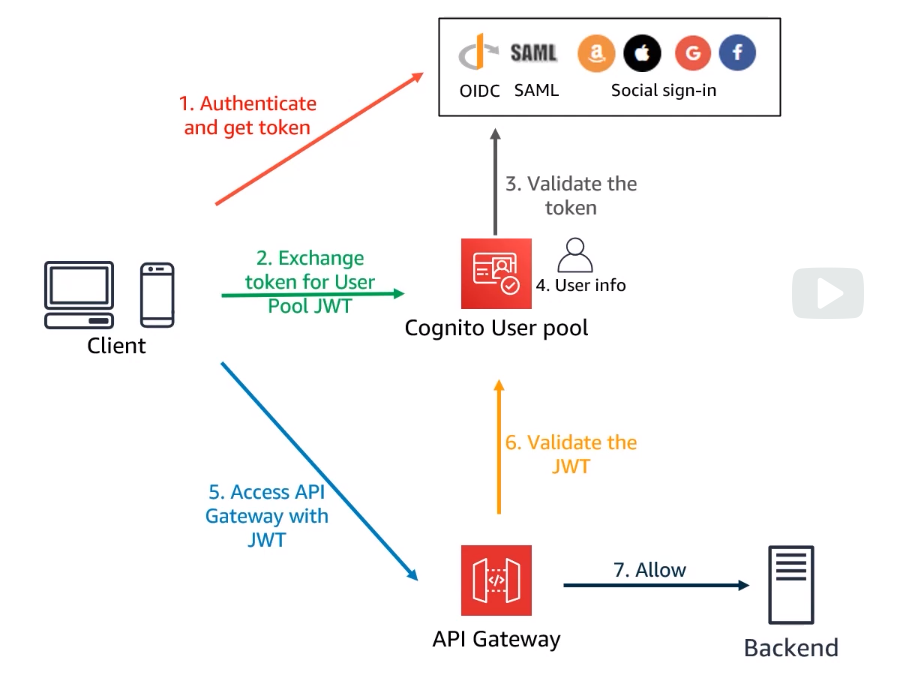
    
The first step is for the client to authenticate via OpenID Connect, SAML, or some social sign-in providers like, login with Amazon, sign in with Apple, Google or Facebook. After the user sign in, the client will receive a token. Just a side note here.
One of the great features of the hosted authentication UI, I told you about earlier, is that it can already integrate with those social sign-in providers. That means you don't even need to pull in any code from those providers or handling the back and forth with these, for those tokens.   
However, here I'm doing it the hard way.   
So the next step for this workflow, is for the client to send a request to Cognito user pool, to exchange the token received from one of those third party and get a JWT token in return. Before providing the JWT token, Cognito will validate the token with the provider. Then it will create a copy of the information it just received. So a new copy of this user info. And it will finally return to JWT token to the client.  
So that second step that is there, right?  
The client can then use that JWT to get authenticated to an authenticated and authorized to API Gateway, like so... which will again validate the JWT token with user pool. And finally allow or not access to the backend.  

  
You may be asking yourself though, why not just directly integrate my application, right? Your backend - with the social providers? Why have Cognito user pool in the middle of all of this? Well, one of those reasons is for authorization. Maybe you are fine with letting anyone with, let's say, Amazon login access your application. However, what if you wanted to give certain users different permissions? Well, you can't really do that from the amazon.com side, however it's possible within user pool. Remember that a user info, that copy of the user info that we made within user pool a little bit earlier? Well, you can assign this user copy, some permissions or authorization scopes within Cognito user pool.  

  
Let's talk about the second service within Amazon Cognito called Federated Identities.  
  
This is a service that's used to assign IAM roles to users who authenticate through a separate identity provider. It does not contain your users and all the information like Cognito user pool. So this is a major difference. Also, there is a built-in rule engine that allows you to select a specific IAM role, based on the data provided by the identity provider you are using. This means that you could provide one role with more permissions, for a certain group of users and less permission for another group, by using different roles.   
  
Let's look at a workflow.  
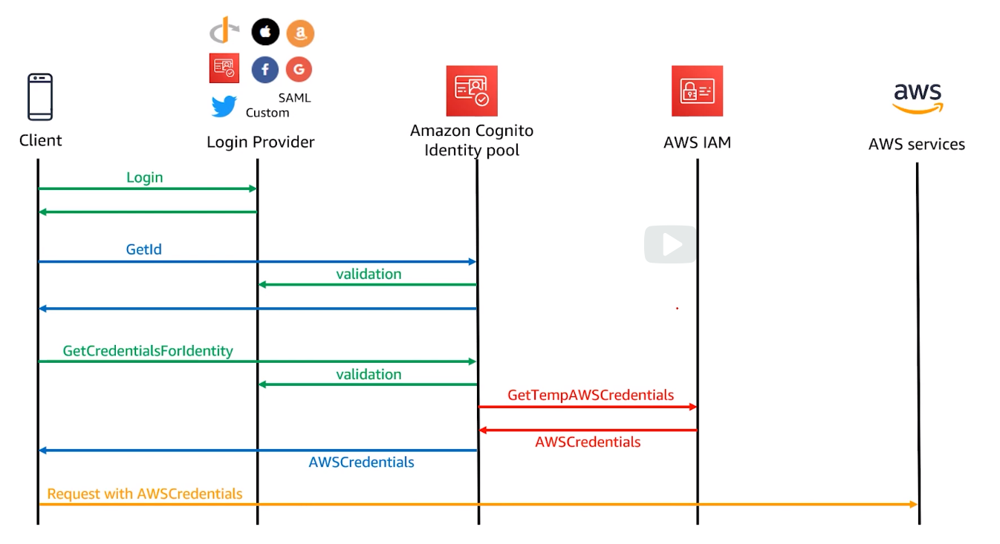
  
First, the client will log in to a login provider. This can be OpenID Connect, SAML, login with Amazon, sign in with Apple, Facebook, Google, Twitter, your own custom provider or Cognito user pool.  
We'll come back to that. Yes, that's right. These two, right? Cognito user pool and Federated Identities, they can work together.
But I'll come back to that.   
Then once you're done with that login, the response will be sent back towards the client. Then the client will send the API call,
get ID to the identity pool, using the token it received from the login provider. That token will be validated with the login provider and identity pool Will let the client know about it. Next, the client will use the API call, get credentials for identity request, for specifying what IAM role it would like to become. That will be validated against the login provider,
and if that's allowed, Cognito identity pool, will request AWS temporary credentials from AWS IAM. Which will then be returned to Cognito, and back to the client. Finally, the client can use those AWS credentials to access any AWS services.  
  
Up until now, I mentioned that you can directly authorize Cognito user pools, in API Gateway via JSON Web Tokens. And now with Cognito Federated Identities, I can actually authenticate with one of these login providers here, which includes Cognito user pool
to also be able to authenticate to any services, which includes API Gateway.  
Wait, that means there's two ways to authenticate to API Gateway?  
  
Let me take you through the workflow of these two services that are working together.  
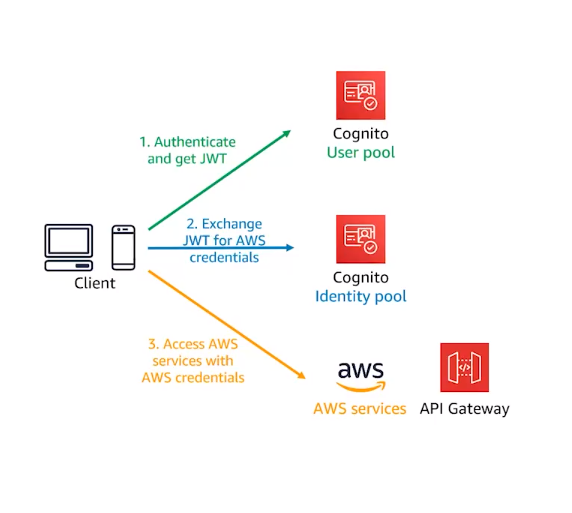
  
First, the client will authenticate and get a JWT token from Cognito user pool. Then it will exchange that JWT token for AWS credentials, via Cognito identity pool. And it can now use those credentials to access any AWS services, including API Gateway. To select this type of authentication within API Gateway, you would select AWS IAM.  
  
Which one should I choose? This mechanism that is right here via identity pool, or authorizing directly via Cognito user pool,
like we saw a little bit earlier? Which one shall I use?   
If you only need to communicate with API Gateway and you want your backend to have more information about the user, then integrating with API Gateway directly wth user pool is a good idea. If you need to communicate with almost any other AWS services directly, then you will need to use the Federated Identities.  

The last feature of Federated Identities I want to discuss is the unauthenticated identity you can give a default IAM role, for anyone that doesn't have credentials to authenticate. For example, this could be to provide a very small amount of access to your backend, while the user isn't authenticated yet, or just doesn't want to. If you think about most apps that you download on phone these days, you can decide to stay anonymous, but you have limited functionalities within the app.  
I don't know you can't even post your highest score on the dashboard somewhere. However, once you log in via a social provider,
you get more access. Now I can post my highest score, great. This is something that Federated Identities provides via unauthenticated identities. It's a great way to provide temporary credentials to users, even if they don't want to share their identities with you.   
  
You now have a better understanding of Amazon Cognito, and the fact that it is made up of two services, that are different, but that can also work together, as well as how they can be used to provide access to your API, in API Gateway.

<pre>


    
</pre>
### Use Amazon Cognito to Sign In and Call API Gateway

Now I want to go over a demonstration of how to configure your API Gateway to attend to gate users via an Amazon Cognito User Pool. Let's look at the steps I will need to do to make this work. On the left side, I have a client that will be the one doing most of the interaction. In this case, I will be using a browser as my client for the most part.
On the right, I already have my Dragons API created that was shown earlier. My goal here is to add authentication and authorization to the GET / dragons API.  
  
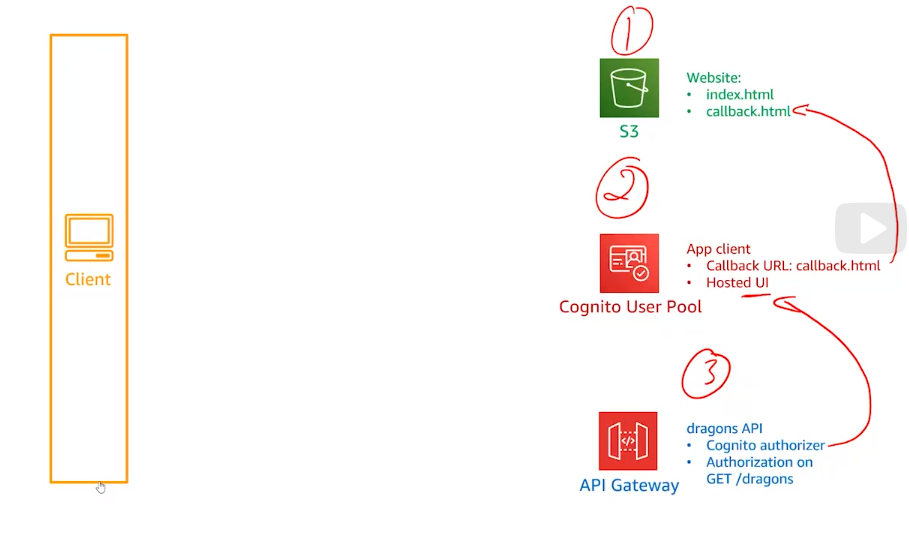
    
My first step will be to create an S3 bucket that we'll be hosting my website. So step number one, it's a very basic website with only two files, index.html and callback.html. which I will upload to S3.  
  
Then my second step is to create a Cognito User Pool. With that user pool which hosts the users, I will define my client application specifying that when the user is authenticated, redirect that user back to the callback HTML page in S3. I will also configure it with the hosted UI to sign up and sign in my user.  
  
For my third and last step, I will configure the dragons API and API Gateway to add it onto an authorizer pointing to my Cognito User Pool, and then I will add this authorizer to my GET / dragons API.  
  
It's time to go do that.  
  
So first I need to create my website in S3, right? That's my first step. So here in the S3 console, that's where I'm going to create a brand new S3 bucket. So let me click Create Bucket.  
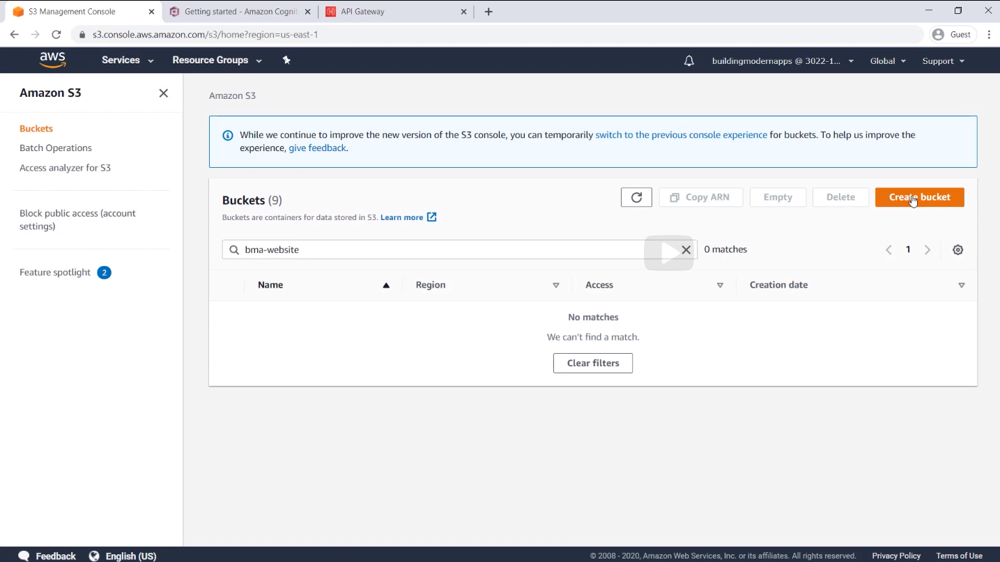
  
I will need to give it a name. So a building modern applications website. Then I'll leave the region as North Virginia, and I'll remove this checkmark, block all public access. As this is a website, so it's fine for it to be entirely public.   
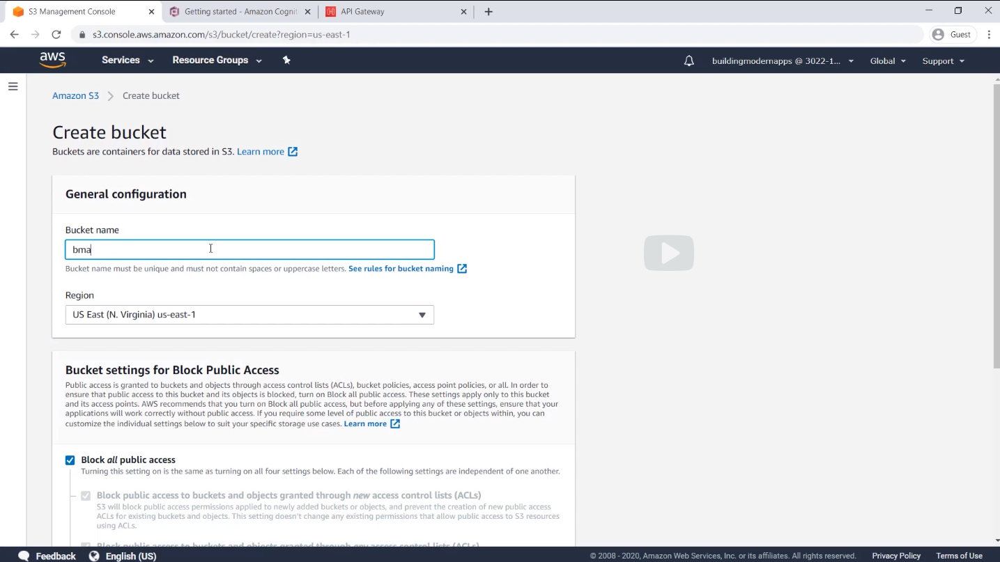
  
And then I'm gonna need to acknowledge that I understand that this bucket is going to be public.
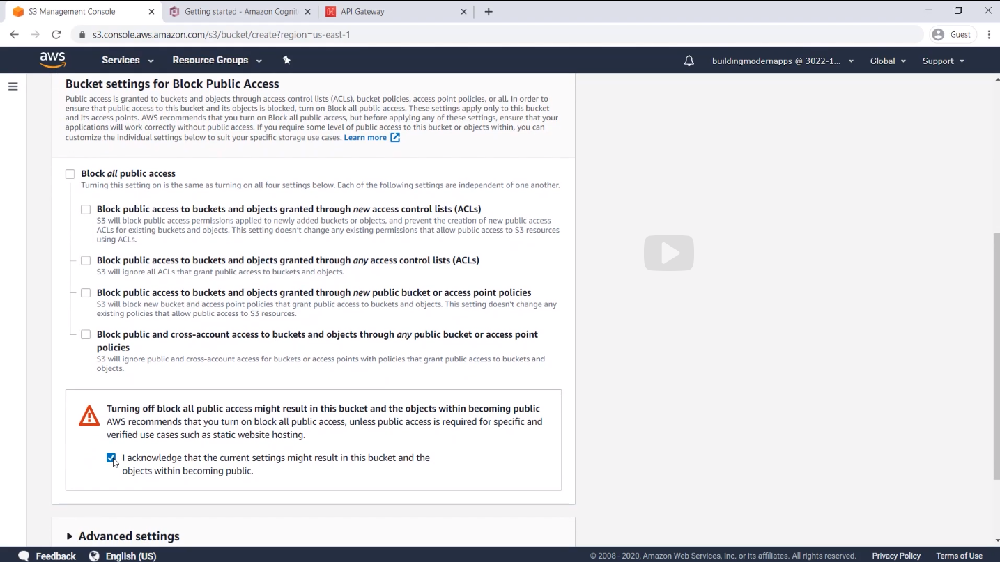
  
Create bucket.  
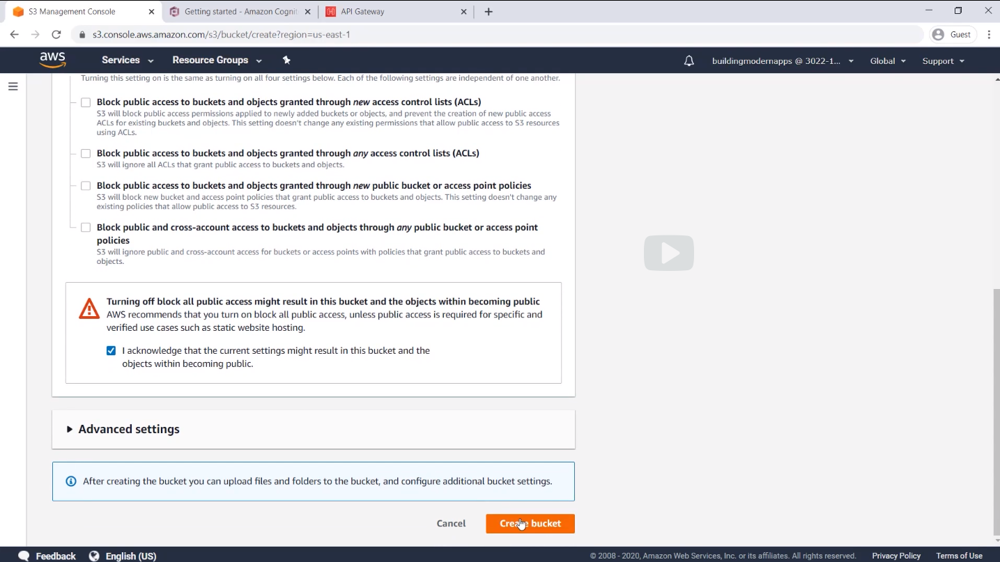
  
Great, I have a bucket. It's time to add my website. Well, two files, right index.html, callback.html. But there is one of those two files that I will need to modify to add some information about my Cognito User Pool later. So I will only upload my callback file for the moment. So to do that, I will click on the bucket name  
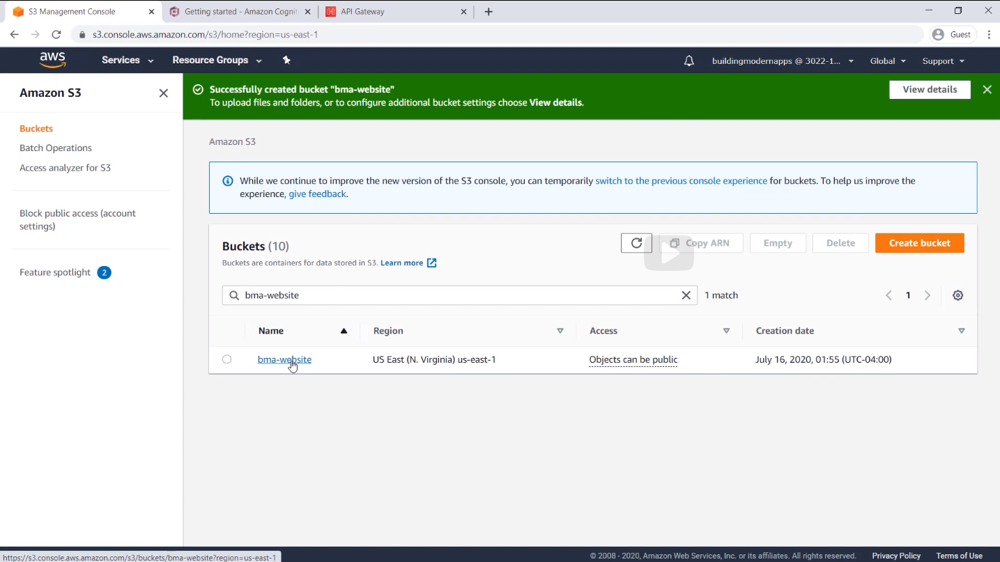
  
and then I'll click on the upload button  
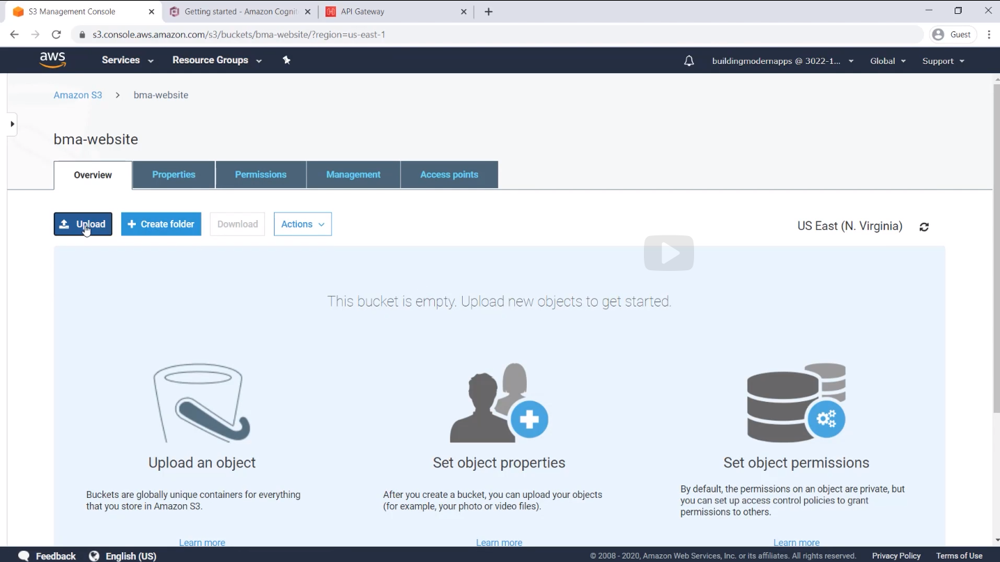
  
click the Add Files
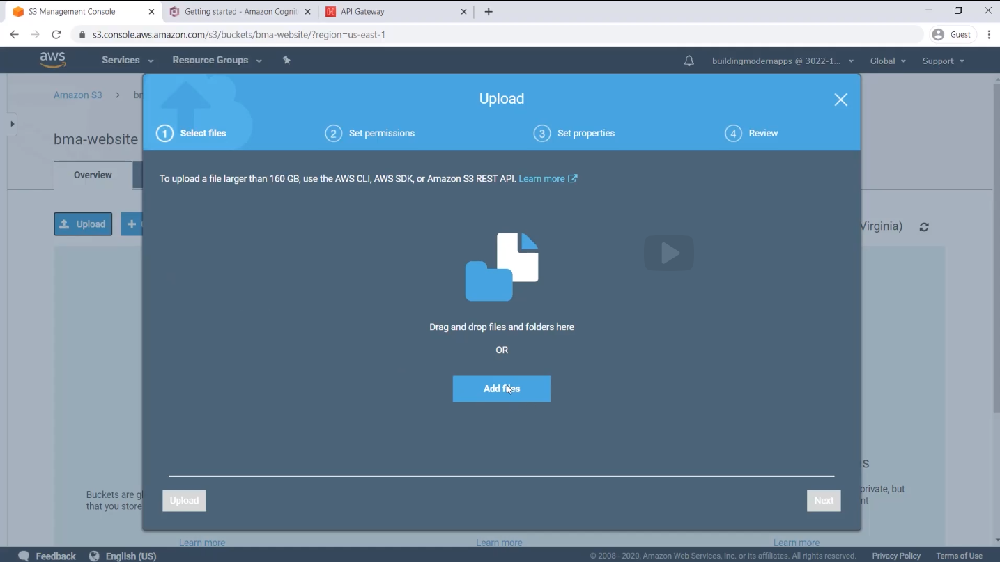
  
and then I will select my callback file  
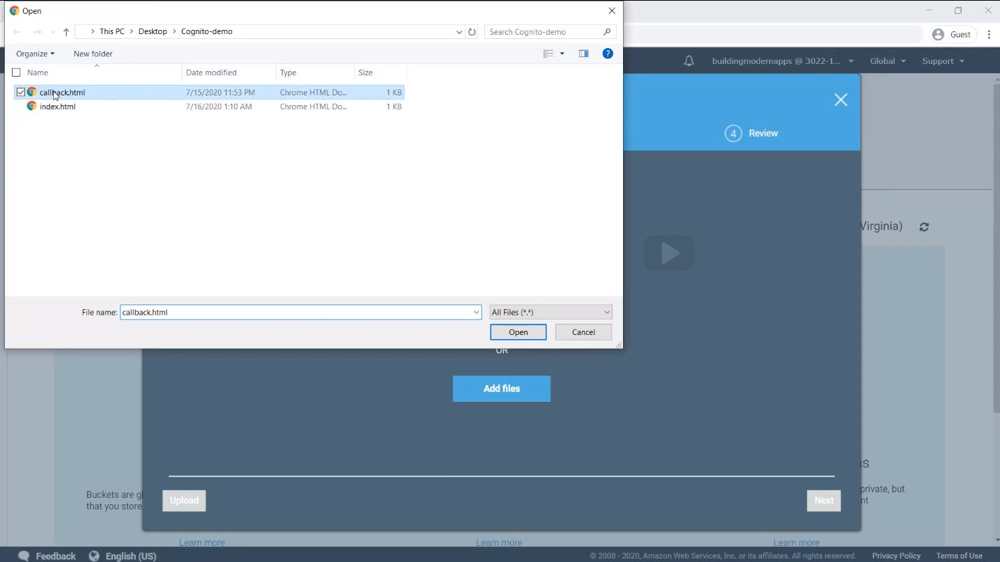
  
open this up, click the Next button  
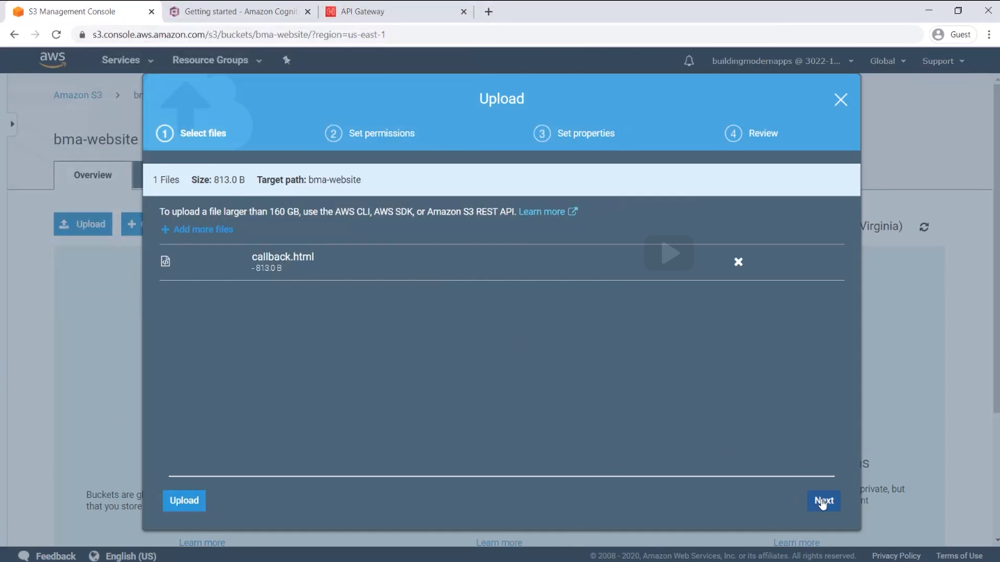
  
and I'll need to select grant public read access to this object which kind of makes sense because it's a website, it needs to be public.   
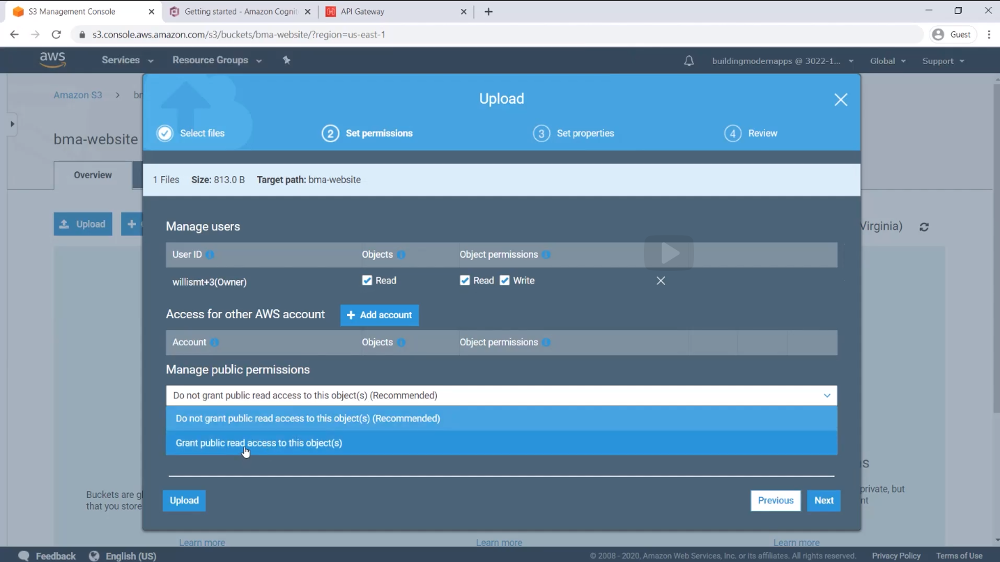
  
Then I'll click on the upload button.  
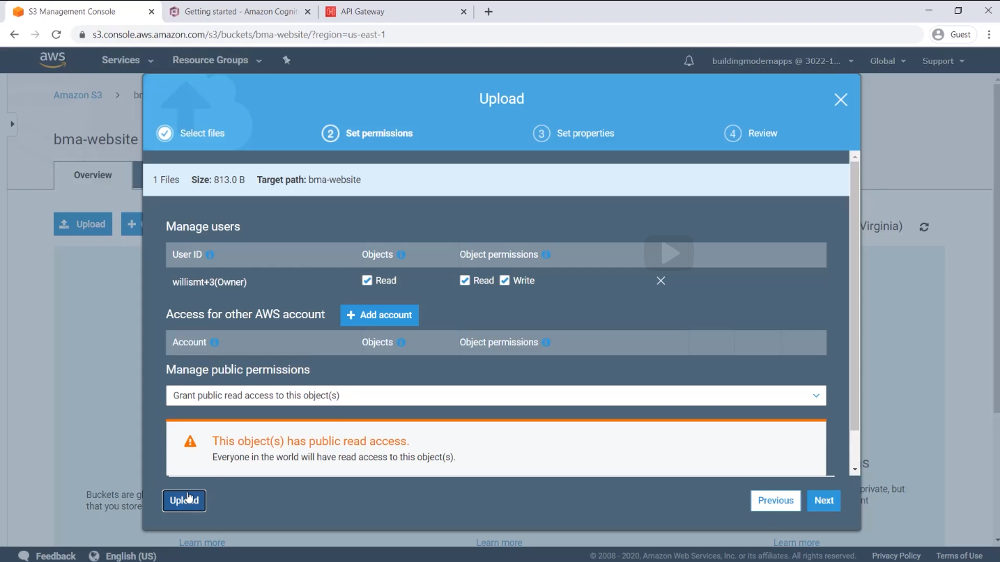
  
And in my callback file is now right here.  
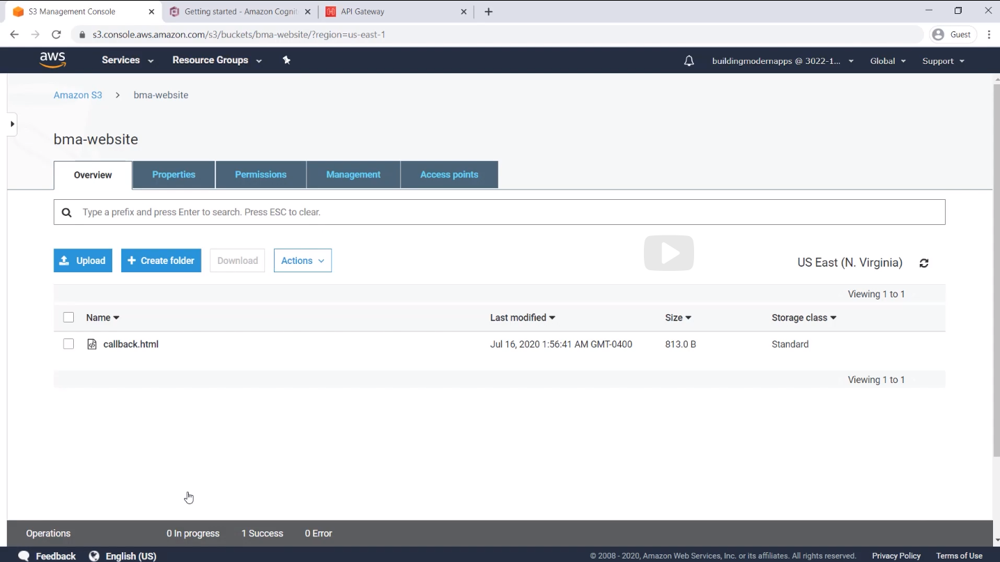
  
Back to my diagram. My next step here, step number two is to configure my user pool. So let's go do that.  
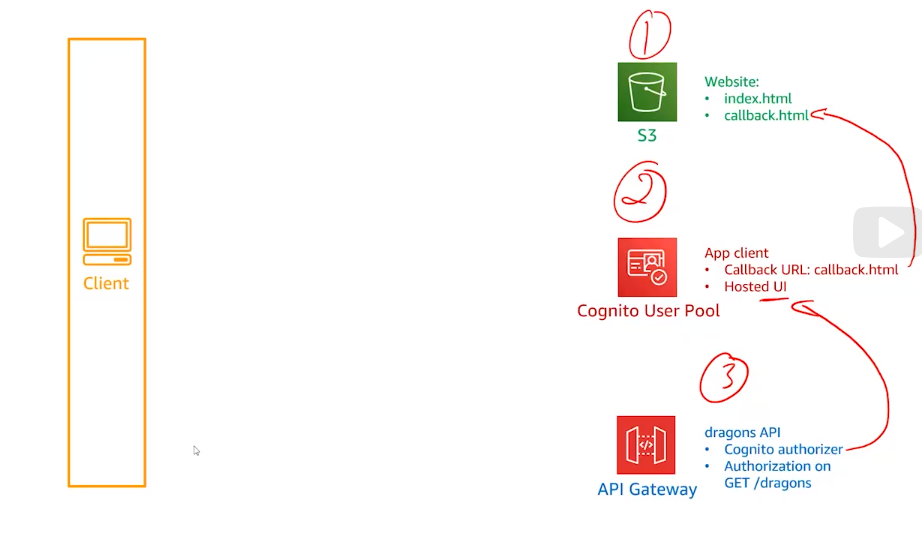
  
Back on my browser, I'm going to go over into the Cognito console where I'm asked which service I want to use. 
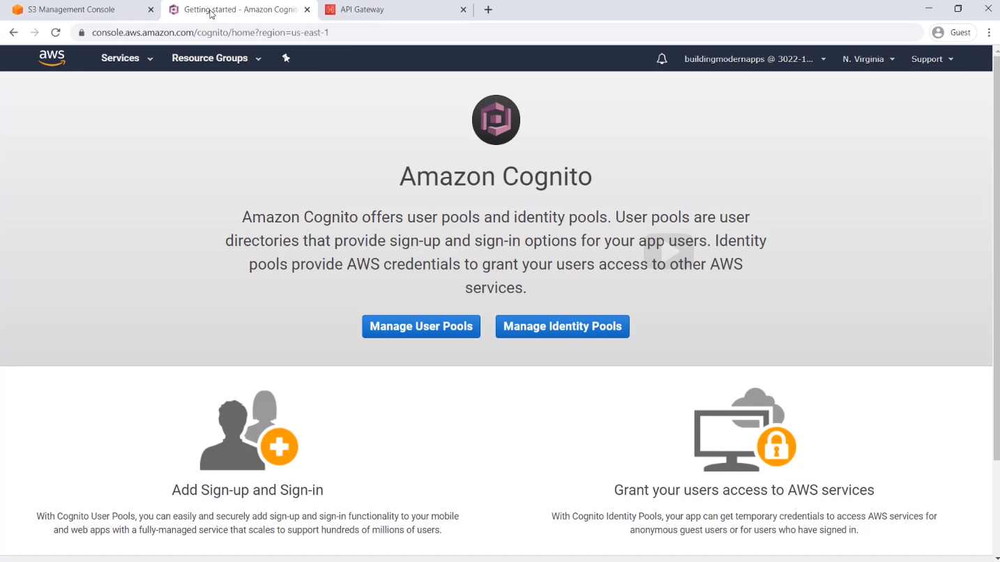
  
And in this case, it's a user pool that I wanna go. So manage user pool 
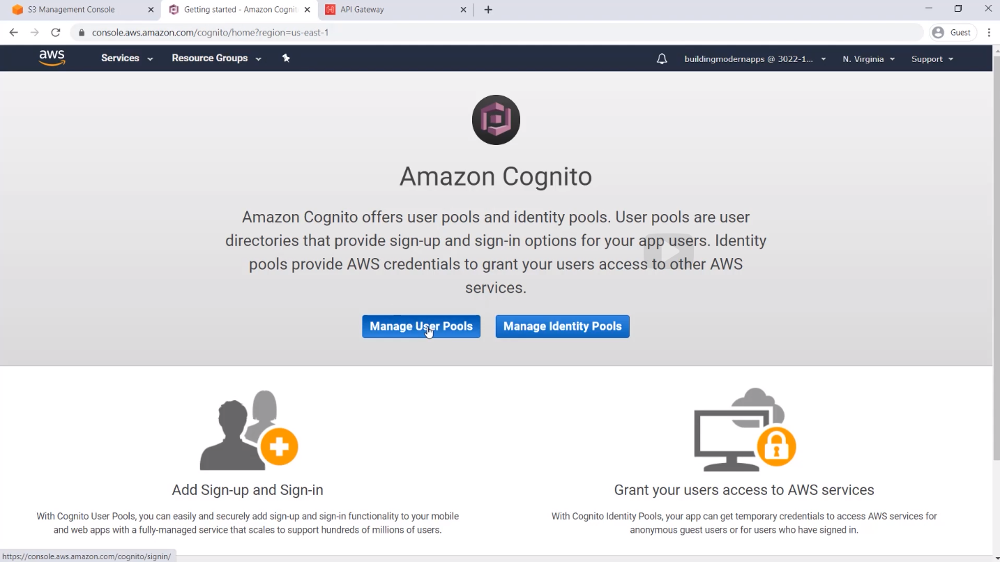
  
and I'll click on create one of those.   
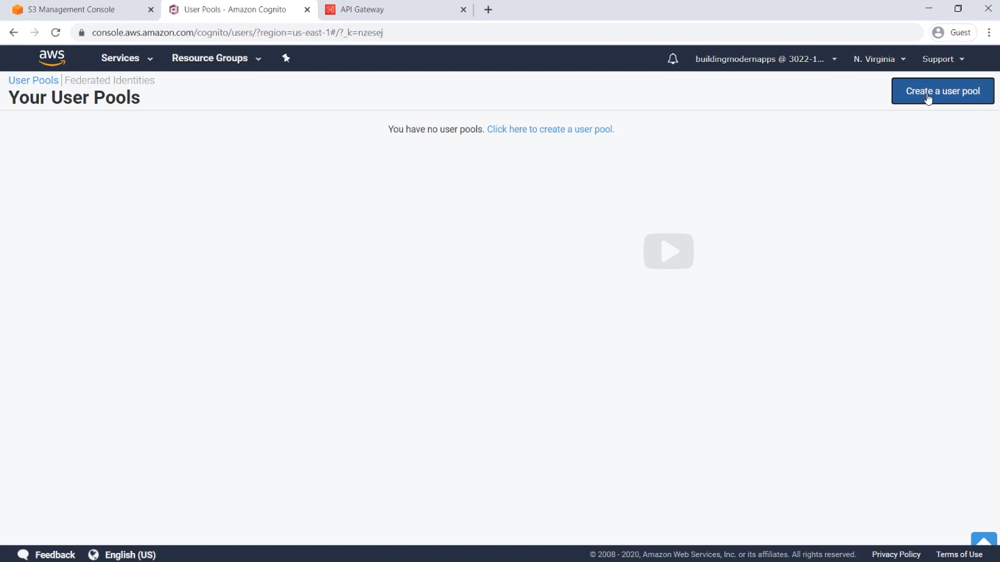
  
The name will be demo and I will mostly be using the default settings from my Cognito User Pool. So we'll just click on review defaults button here.  
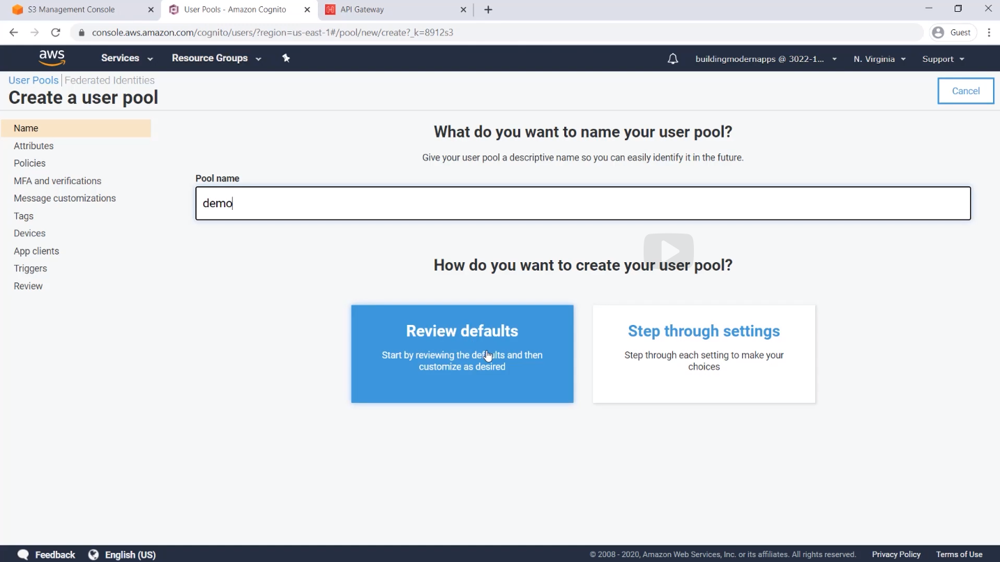
  
You can see in this page what those default features are. The email is a required attribute. There are some password requirements,
as you can see up there. So like the passwords training policies. The users, they can sign up and sign in on their own. So they don't need administrators to do that. Multifactor authentication is disabled and it looks like I'm asking for email to be verified in this case. That looks good to me, right?  
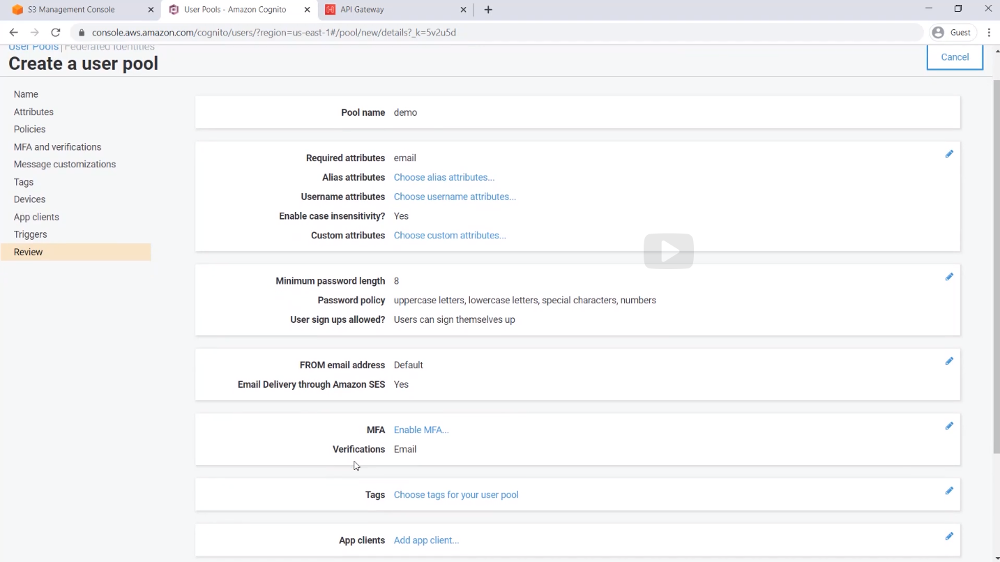
  
So let's click on Create Pool here.  
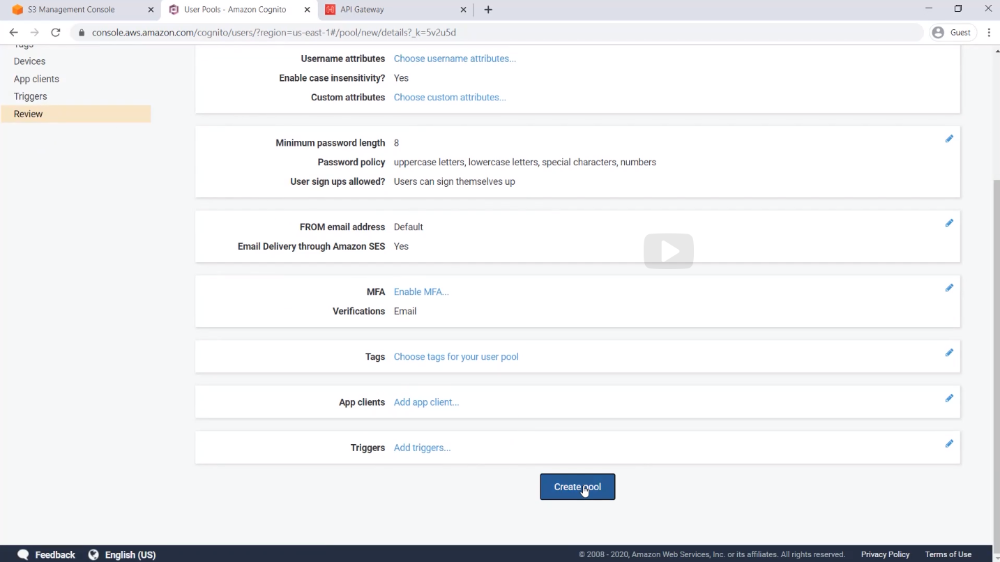
  
My next step is to configure the domain name of my hosted UI to do my authentication authorization for me, It's gonna click on the domain here.  
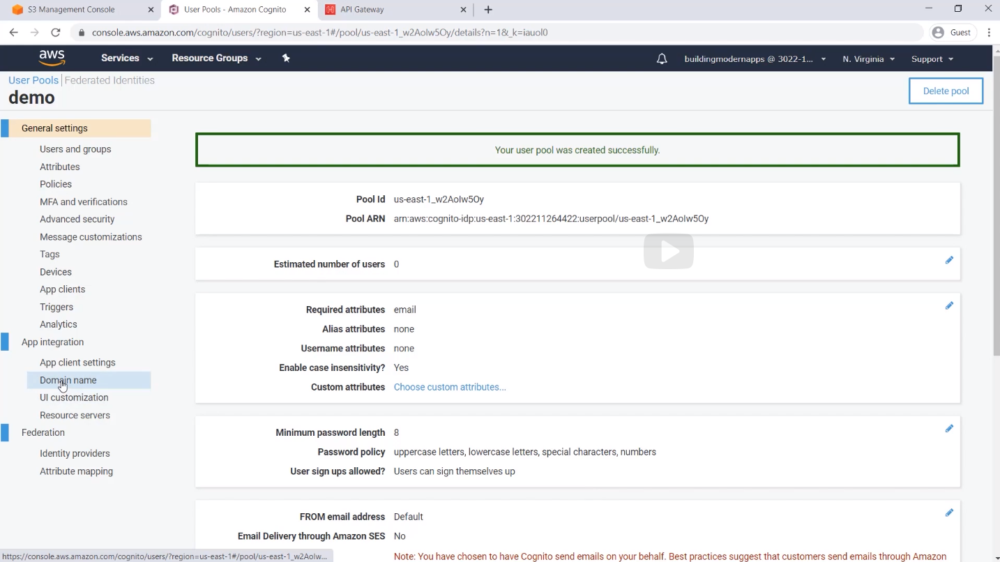
  
And I have two choices. I can either configure and use a Cognito domain name or my own domain name, which is nice. If you don't want any of this Amazoncognito.com to actually show up in the URL, I'm fine with seeing that in the URL. So I'm just going to type a domain names here. So again, BMA website and then dash, I don't know, four or three here. So check availability  
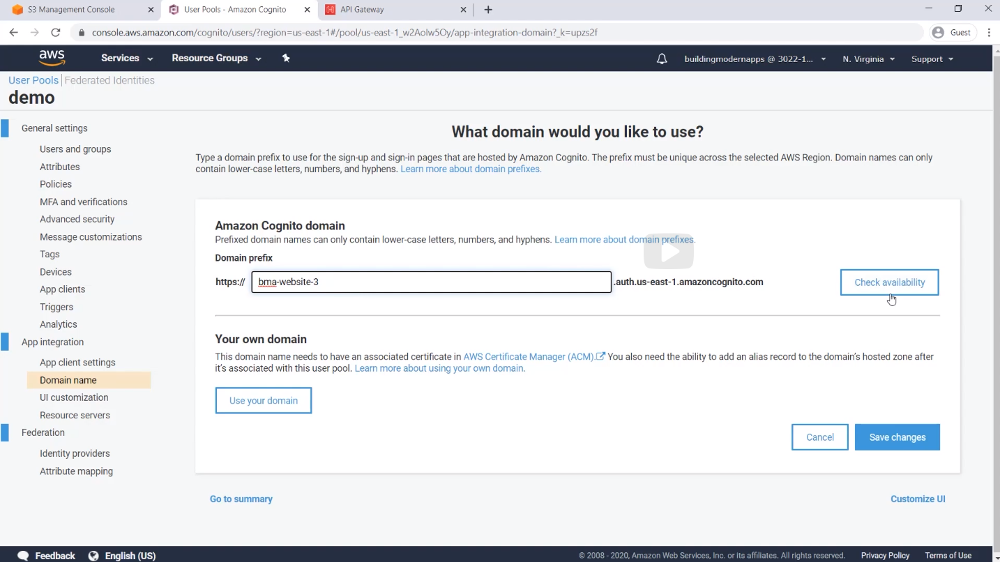
  
the domain is available, perfect.  
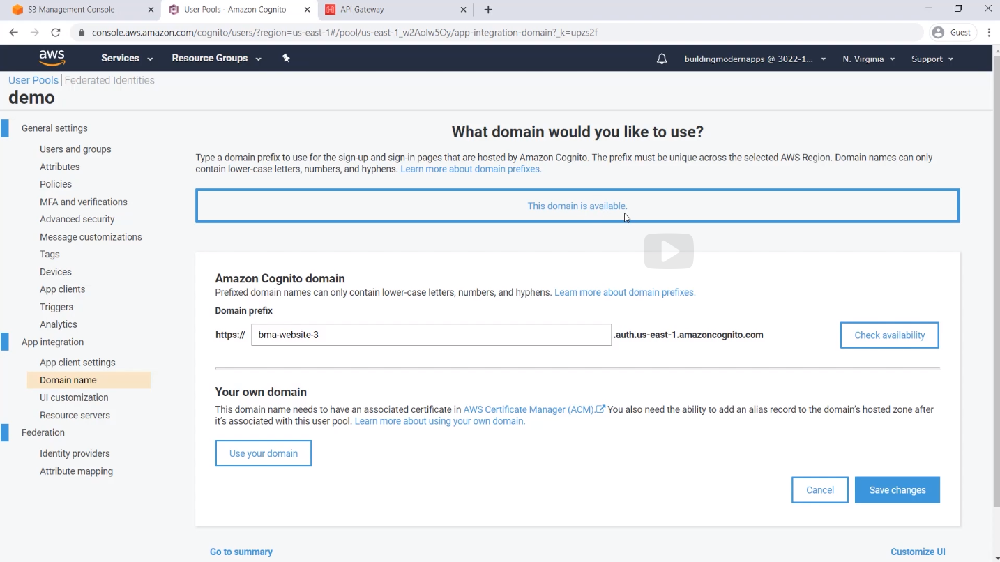
  
I will hit Save Changes, great.
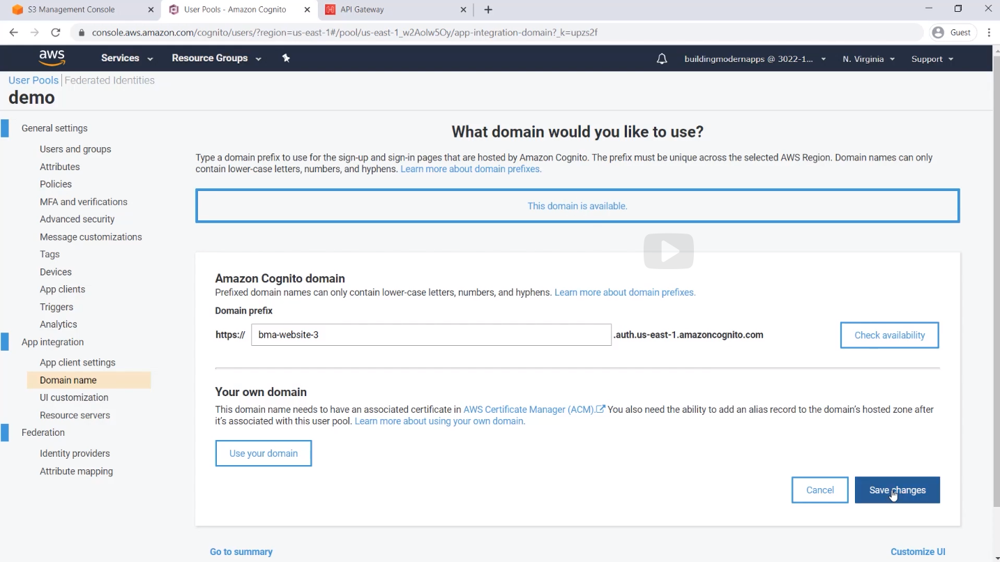
  
Next I need to define an app client.  
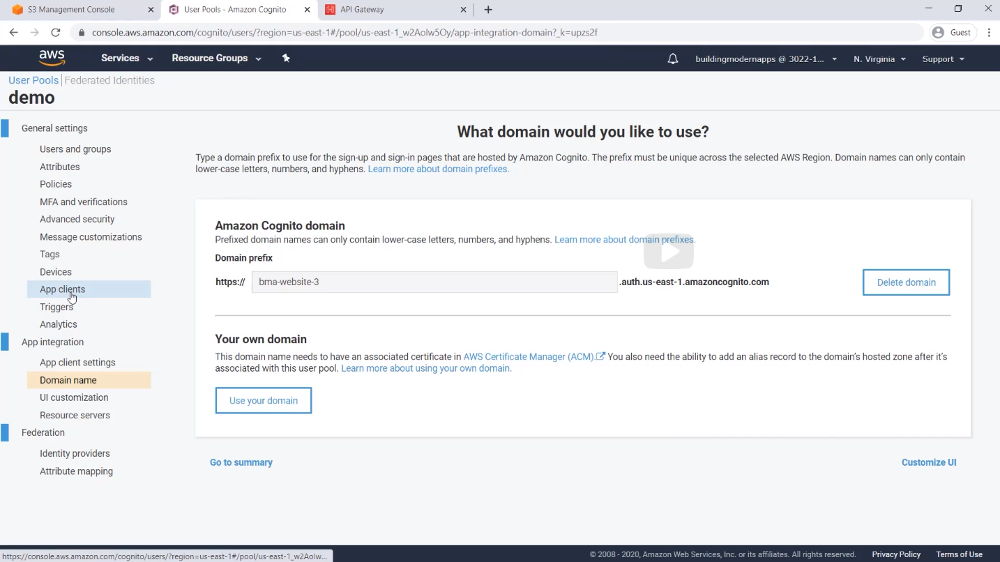
  
We haven't talked about app clients. So let me give you a brief description. Our user pool contains your users, their information,
username, password, email, phone number, et cetera. Now this user pool doesn't exactly relate to one application, right? One API Gateway, one app. It can be a one to many applications. However, each one of these totals, all those applications, they need own settings for doing the authentication flow. That's why we have app clients or application clients. These are the definition of each one of these application that is going to use Cognito User Pool as their database of users.  
  
In my case, I only have one. So I'll add only one here. Add a client.  
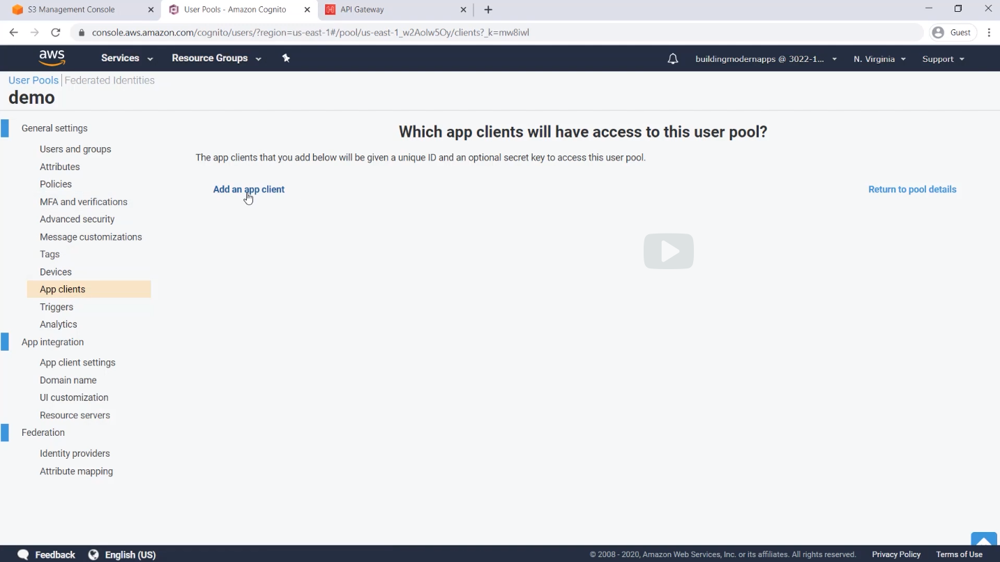
  
For the name, I'm going to give it a certain name, BMA website.  
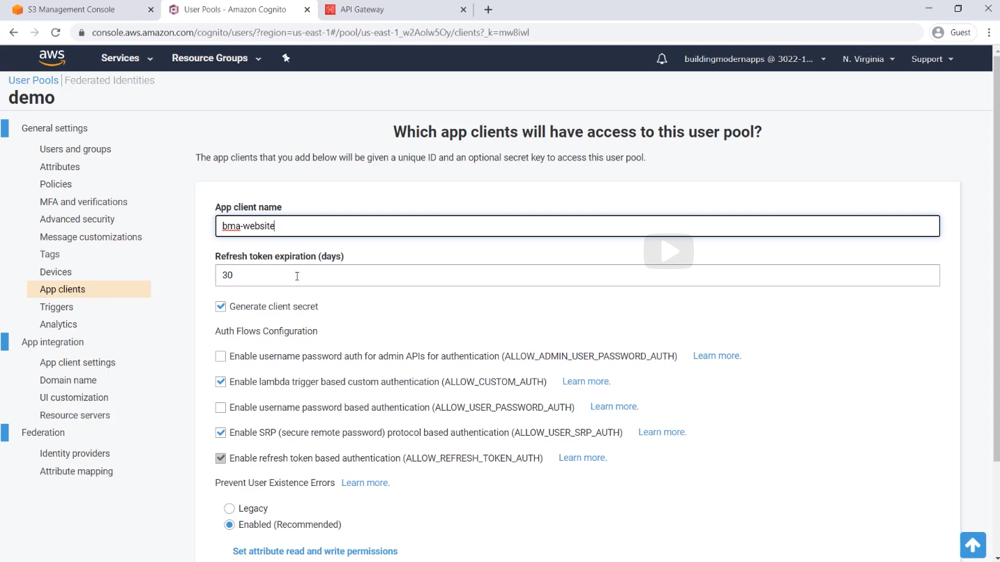
  
Next, this refresh token expiration allows me to say, how long are user can stay logged in. 30 days right now, okay? I could change that if I wanted to. Then I will remove this generate client secret checkbox. This is more for a server to communicate with
like server to server kind of communication. So if I had a backend that I wanted to call directly from Cognito once it's logged in and do a back channel, but I'm not doing that at all here. So yeah, I'm just going to remove this, the other settings for the authentication flow that are here, I'm all fine with them. So I'm gonna hit the create app client.  
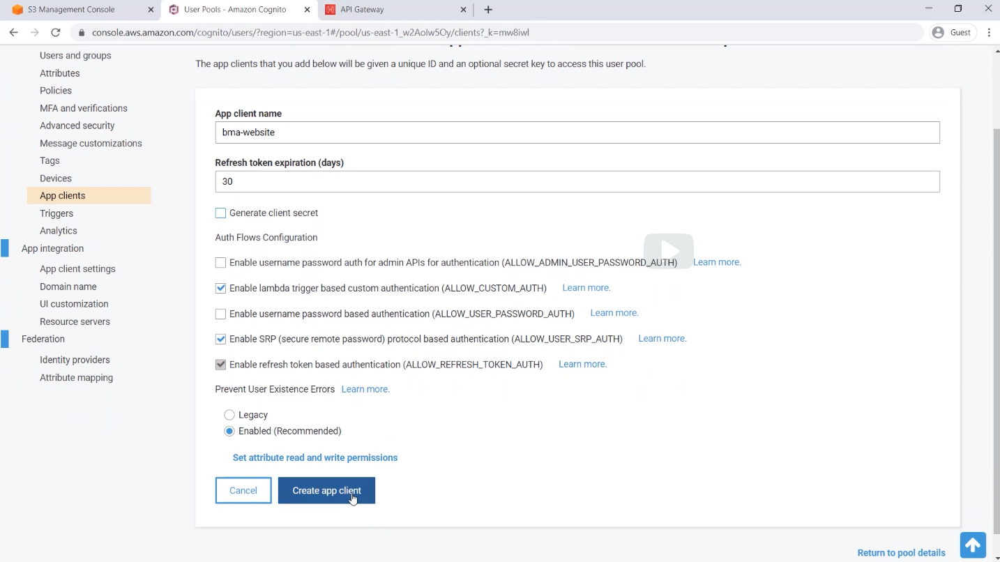
  
Then my next step is to change some configurations in the app client settings that goes back to this app client that I just created.  
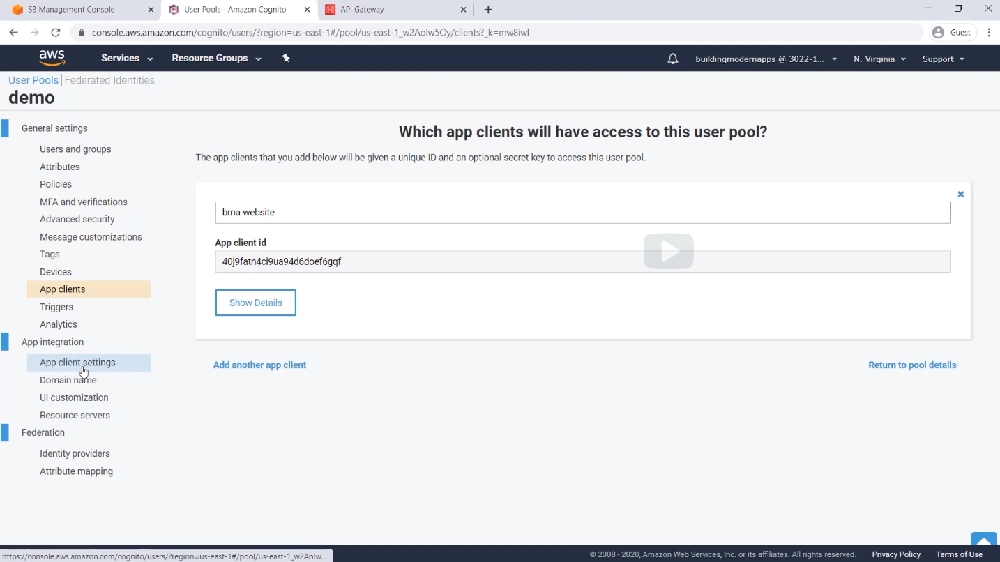
  
The first one is I want to enable Cognito as my identity provider for my application. Yeah, that's by user database. Then I need a callback URL so when my hosted UI will be done with authentication, I need to send a client back to my website with the authentication token. So this is the URL of my callback file in S3. So let's go get it.   
I'll click on to my S3 console, click on this callback here. And I have the object URL name rights here. So I'm gonna right click on it. and copy the link address, perfect.  
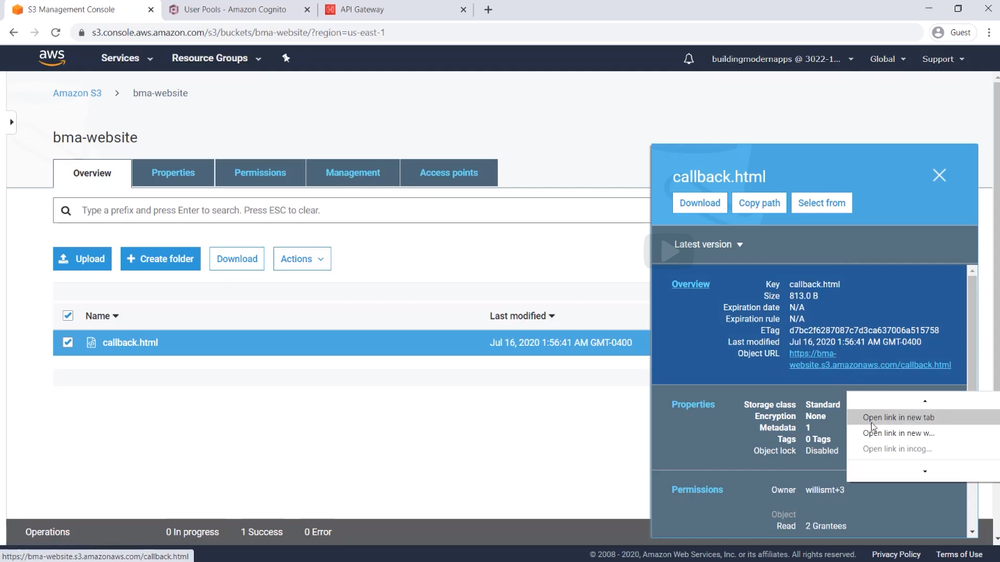
  
And then I'll go back and input that to my callback URL. Awesome, that URL is now, how can you do, we'll send it back. And that's part of my callback field.  
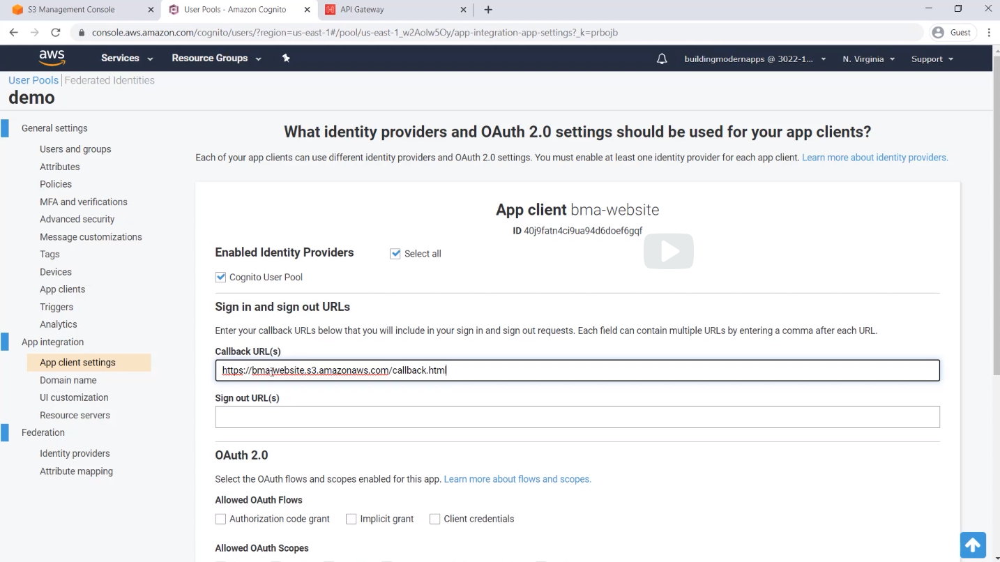
  
Next I'm going be using an implicit grant here for my o-auth flow. This means that the JWT token will be returned back to the client and not be hidden or be using some kind of back channel for this. Next, I need to say what scopes I will like to give
as part of the JWT token. I want to send back the email here, open ID and then profile. Those are all good for me to be sent back towards a client within that token. This is going to be part of that token itself like I'm saying, all right? So in case the back will like to use it, it's going to be in the token being provided to it. Okay, perfect. So I'm gonna hit Save here. So save changes.  
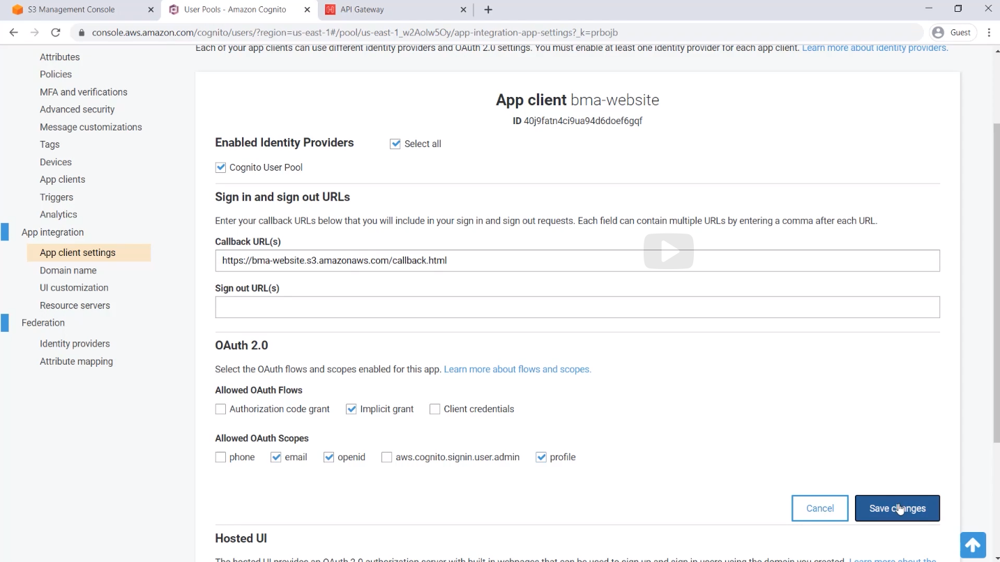
  
And if I scroll a little bit down, my hosted UI is now ready. So let me click on this launch hosted UI and see what it looks like, right?  
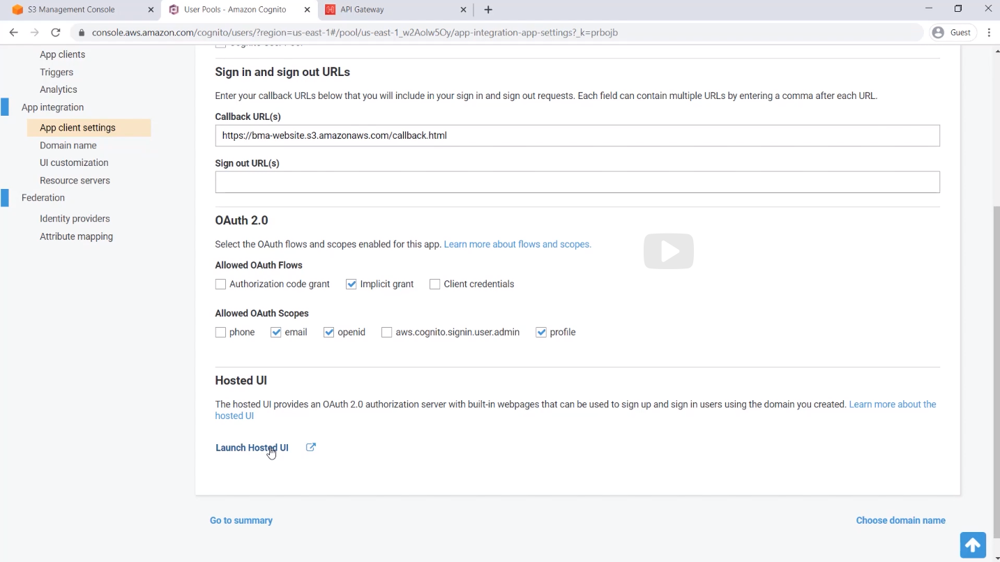
  
So as you can see here, this is going to allow me to sign in and even sign up my users. I won't even need to code.  
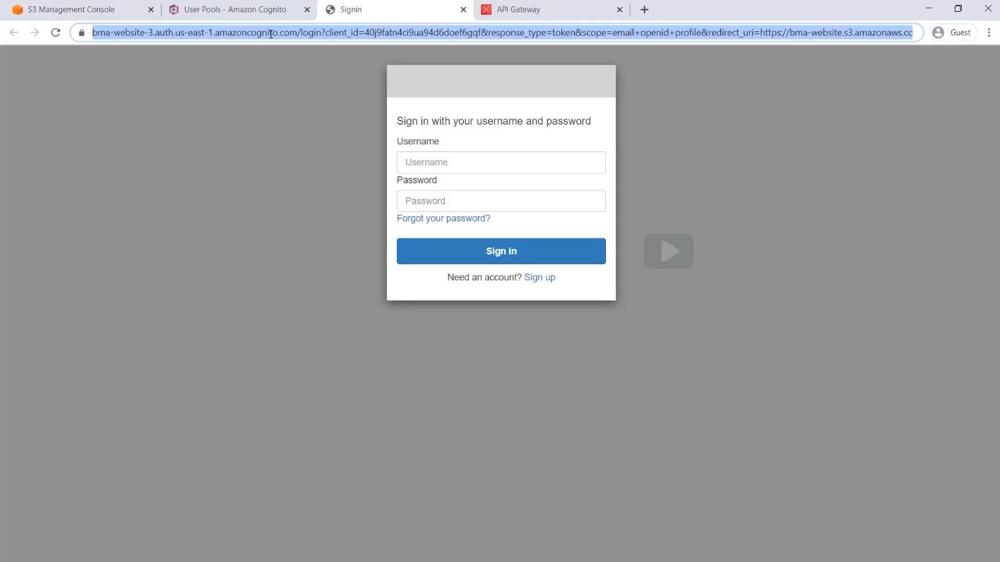
  
I know it may not look pretty according to your standards, but remember that you can modify all of that. Now that I have this URL at the top and just going to copy it, as I will like to use it in my index.html file, because that's where I want to point my users to, like this website here, when the user click on the sign in button for my website.   
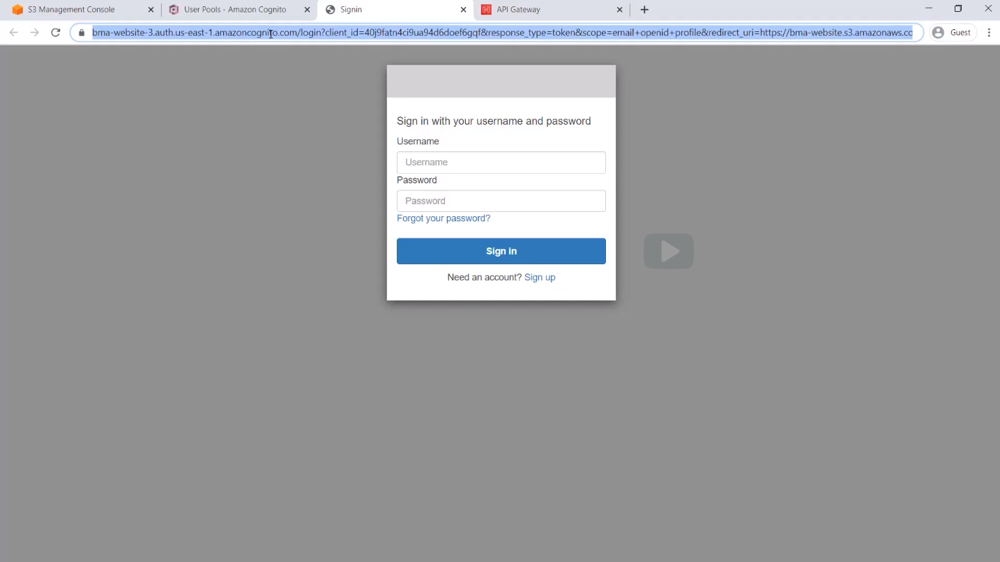
  
So let me show you that code of index.html.  
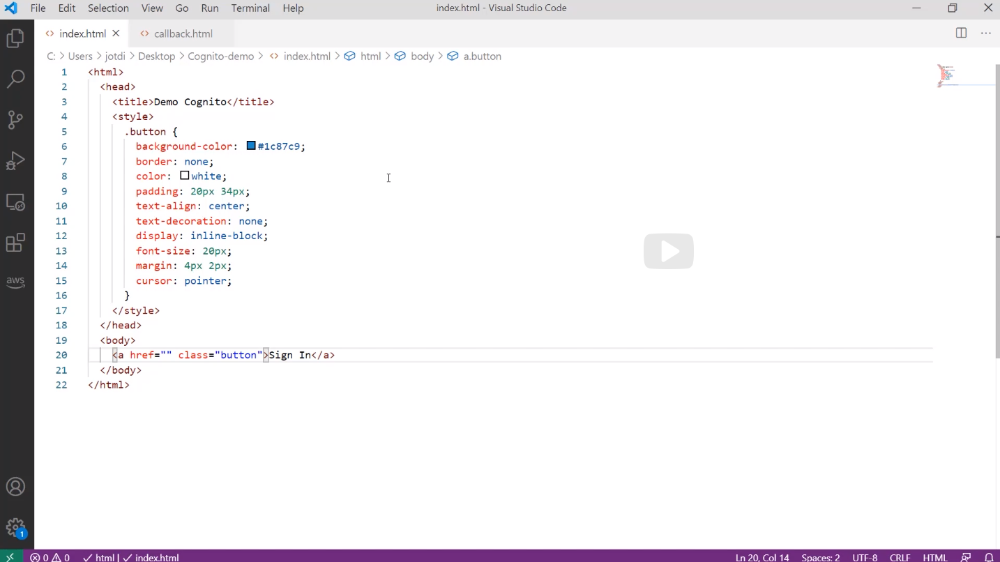
  
As you can see, it's quite simple with 22 lines. I have some CSS at the top to make some stuff pretty, and then I have my sign in button that is right there. It's actually just a link. And then that link is supposed to be pointing to my Cognito hosted UI. So let me add it right here. There it is. I've now added my hosted UI and I will save that and I will just save that little file here.  
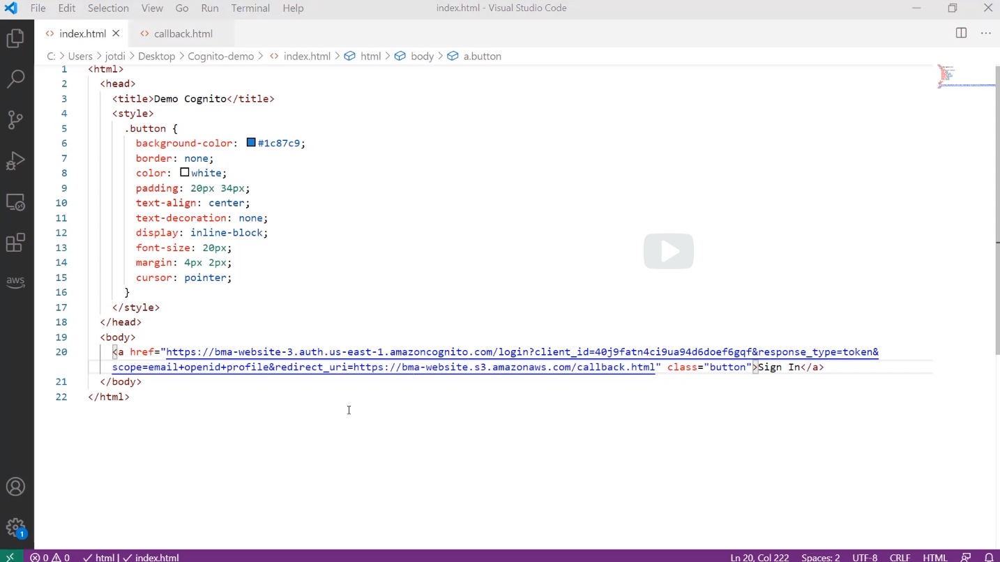
  
So what do I do with this now? I can now upload this index.html file back into that S3 because it's done, so let me go do that. Inside of my S3 console, click the upload button 
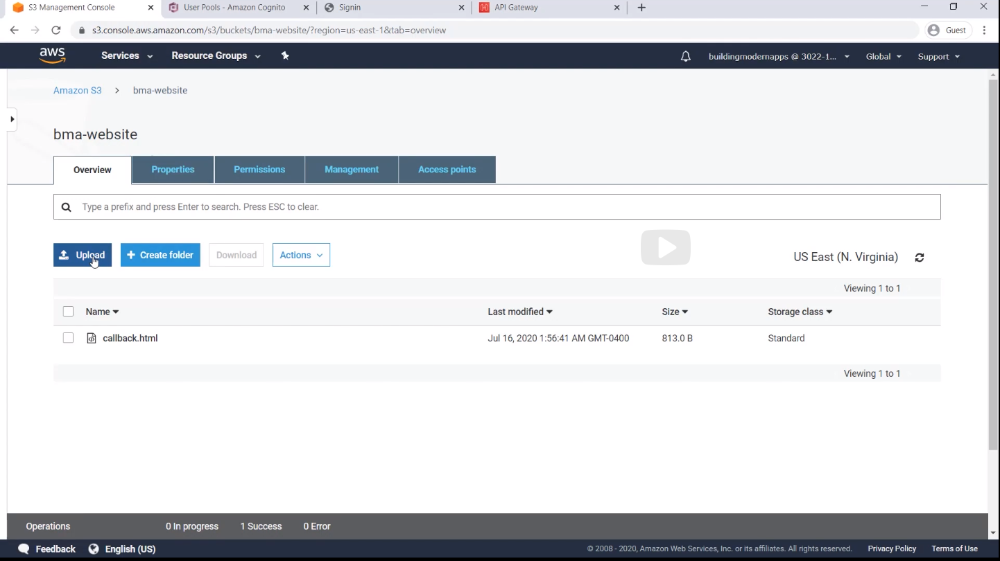
  
and file,   
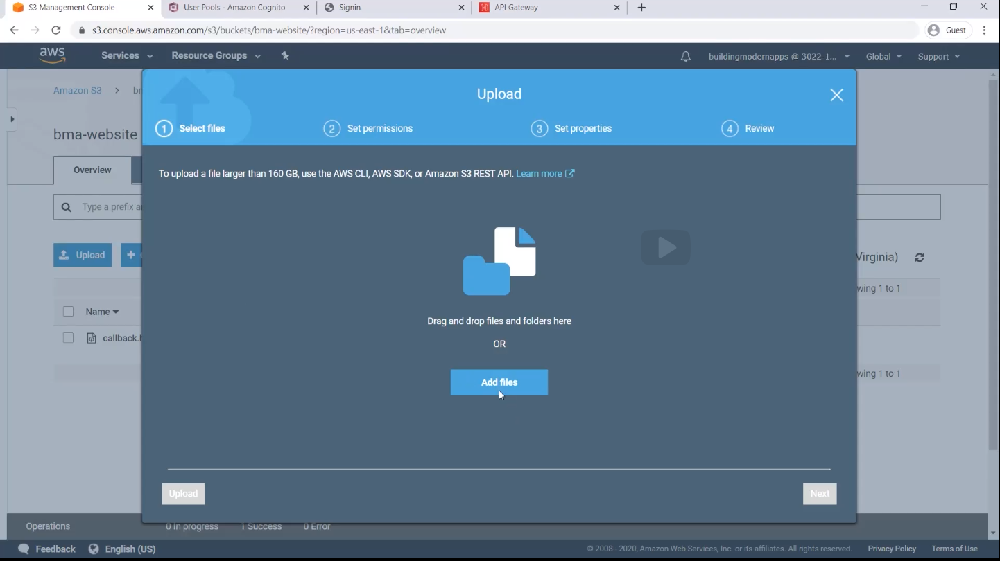
  
index.html file.  
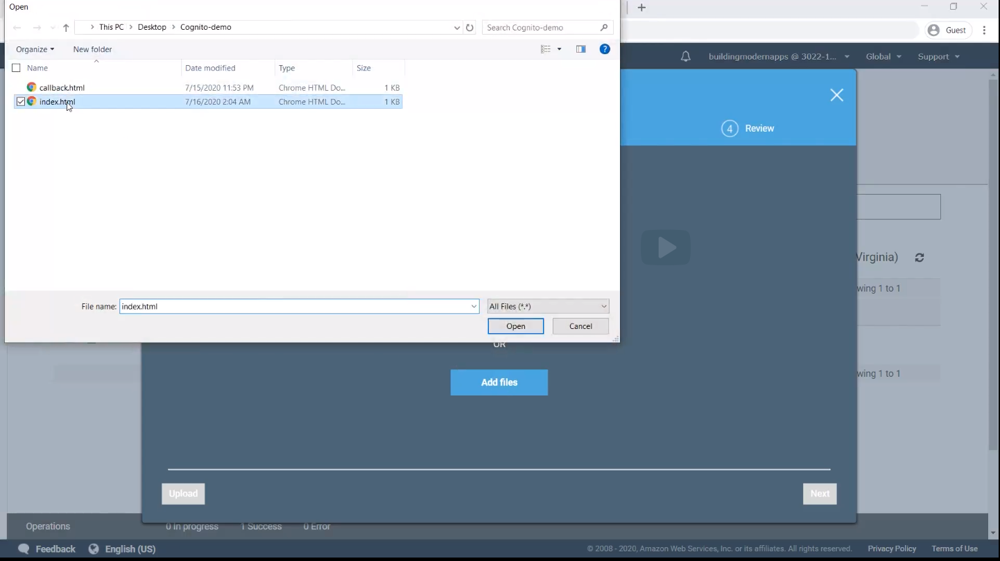
  
Click Next,   
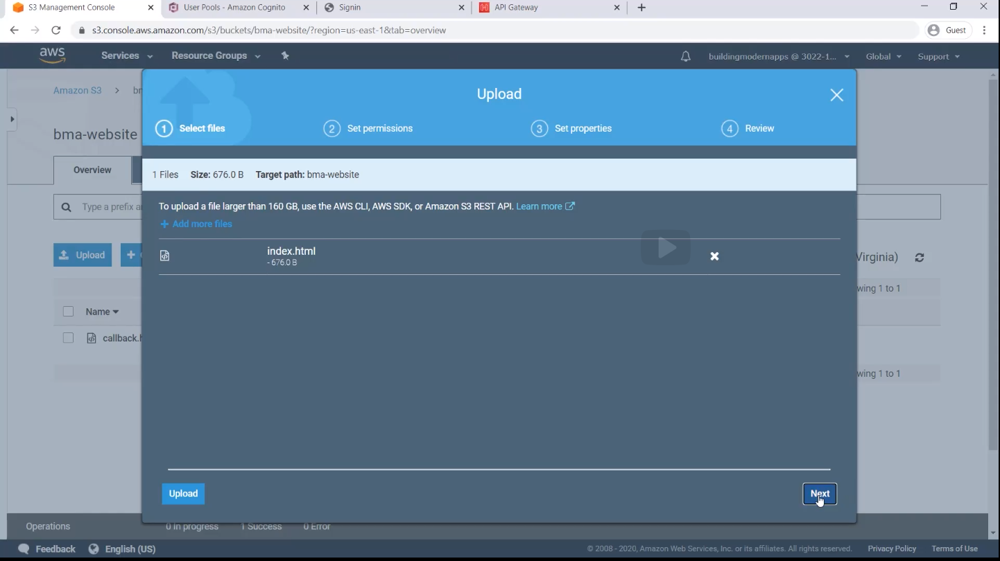

granting read access to this object.  
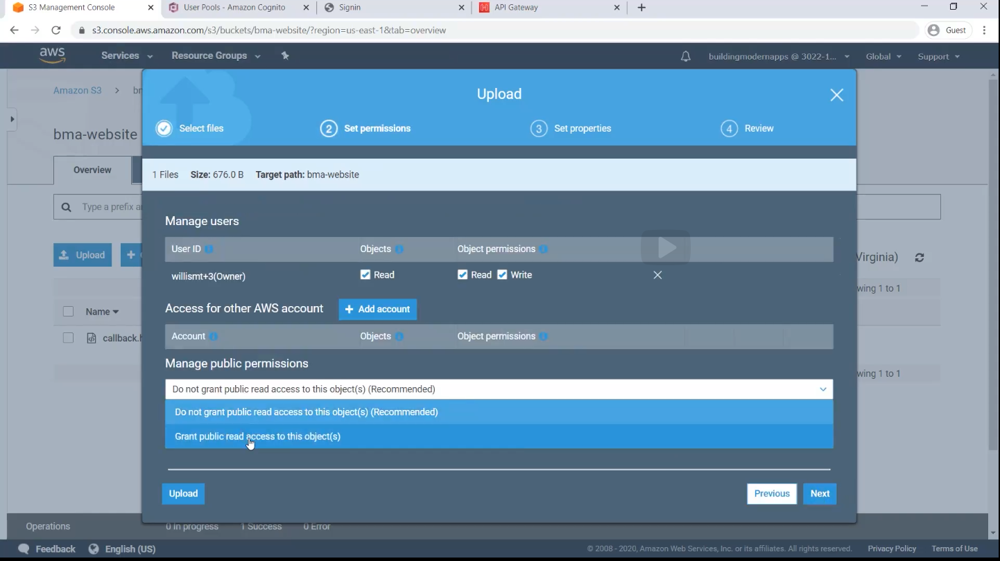
  
Yes, I'm still fine with that, and click the upload button.  
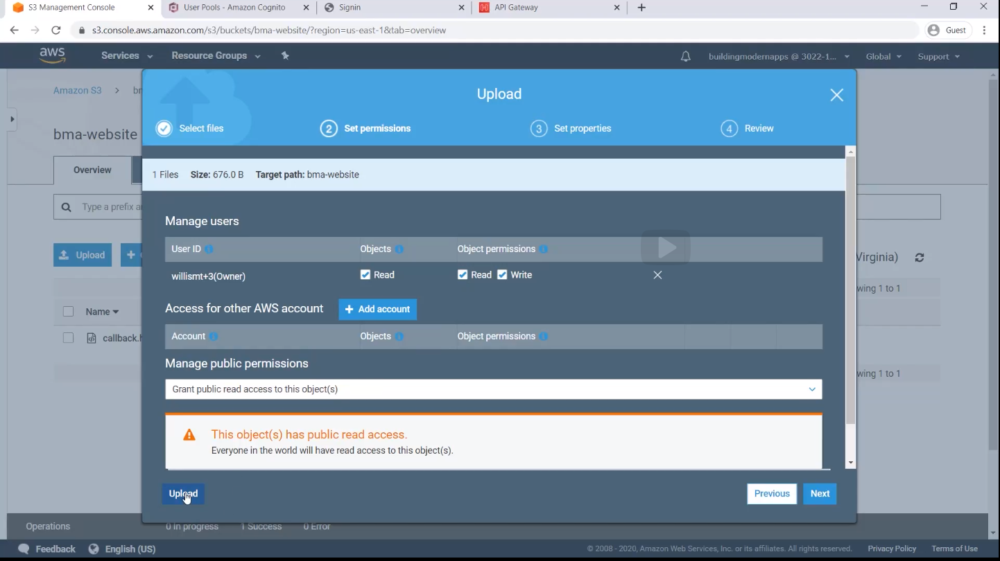
  
Now everything with S3 and Cognito is done.  
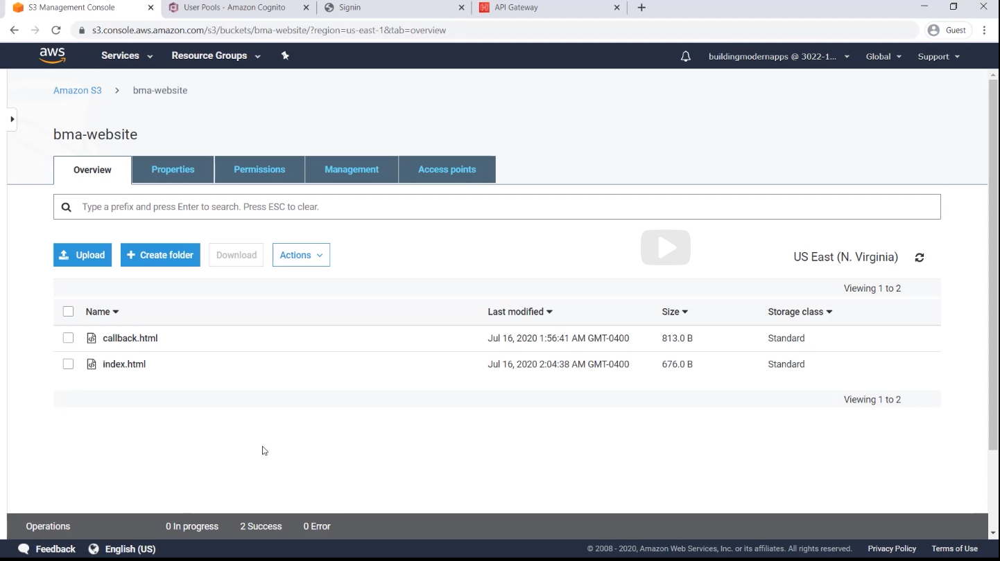
  
Wasn't that easy?  
So what's the last step here?  
Right, the last step is to configure an authorizer in API Gateway and modify my get / dragons, right? Step number three  
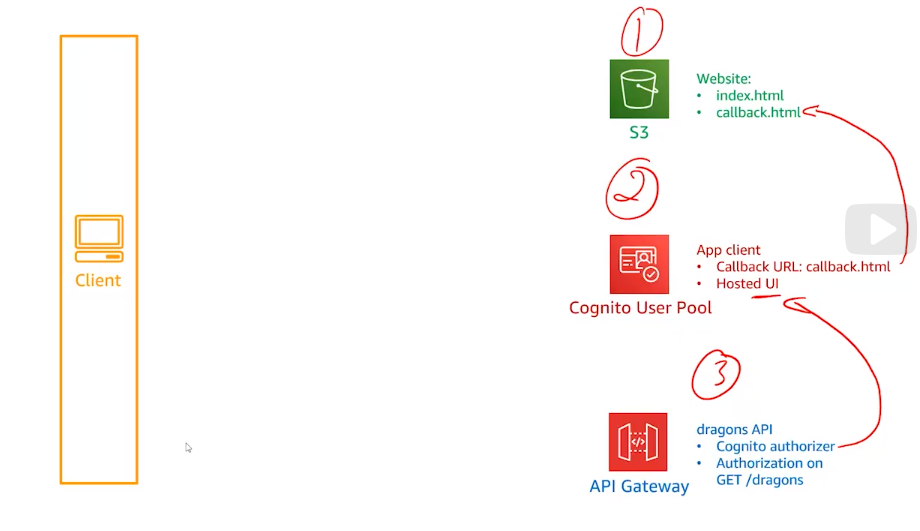
  
To do that, I'll switch over to my API Gateway console  
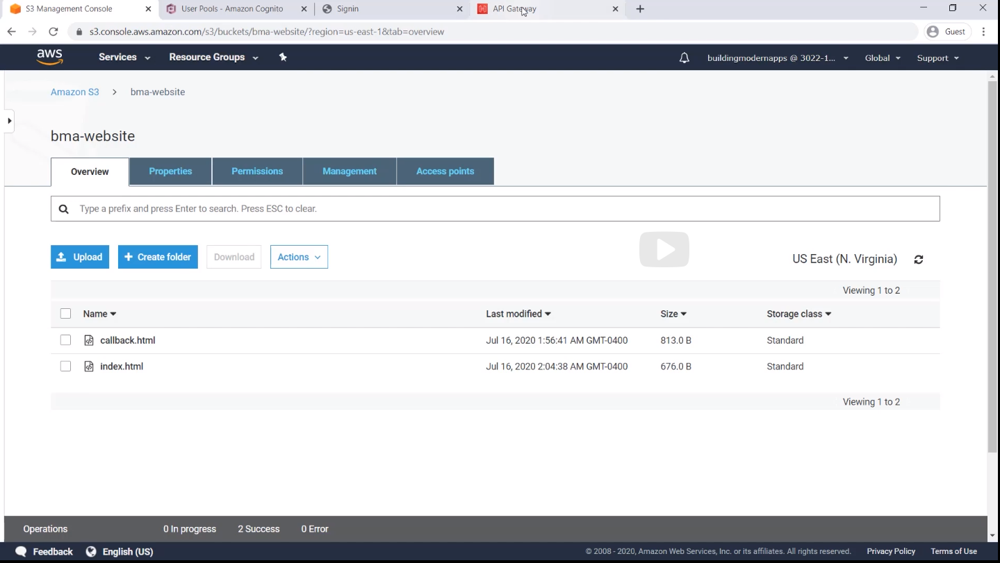
  
and I am going to click on the dragons API right here.  
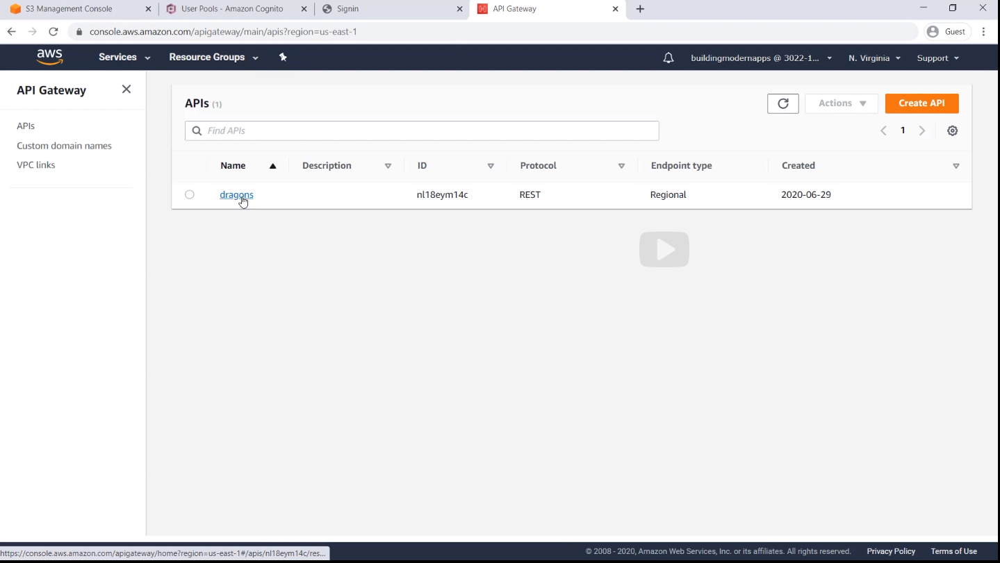
  
Then I'll go under the authorizers of this API   
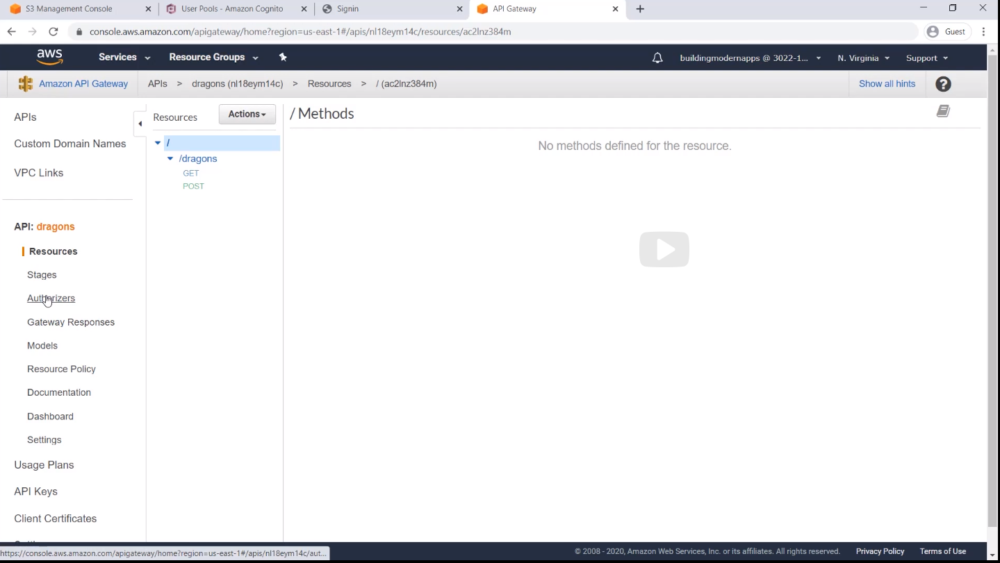
  
and click the Create New Authorizer.  
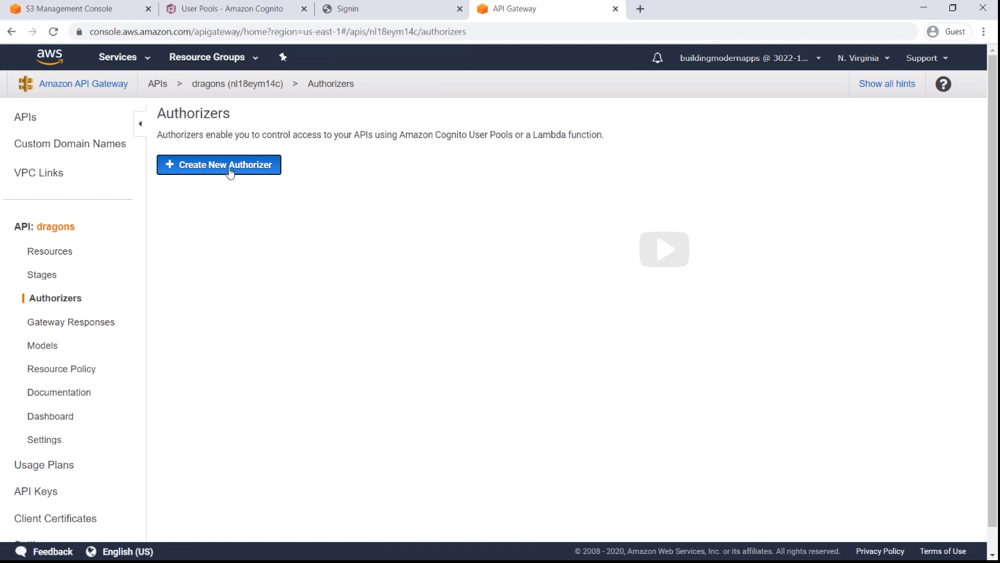
  
I'm going to give it a name called demo in this case. And it's a type Cognito, it's a Cognito authorizer. Then if you remember, what was the name of my Cognito User Pool? It was demo as well. There it is, so I've just added it. Now I need to tell API Gateway
what will be the name of the HTTP header that will contain the JWT token that will be passed to it. For my application, I'm going to be using the authorization header. Then I'll create this authorizer, create.  
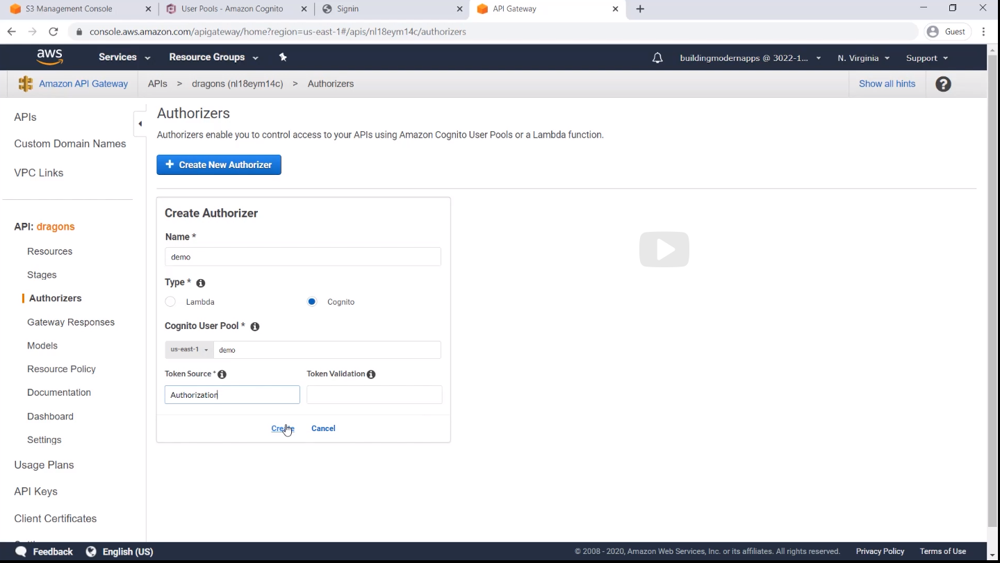
  
My next step is to modify my resources that I have for this API. So to do that, I'm gonna go over resources  
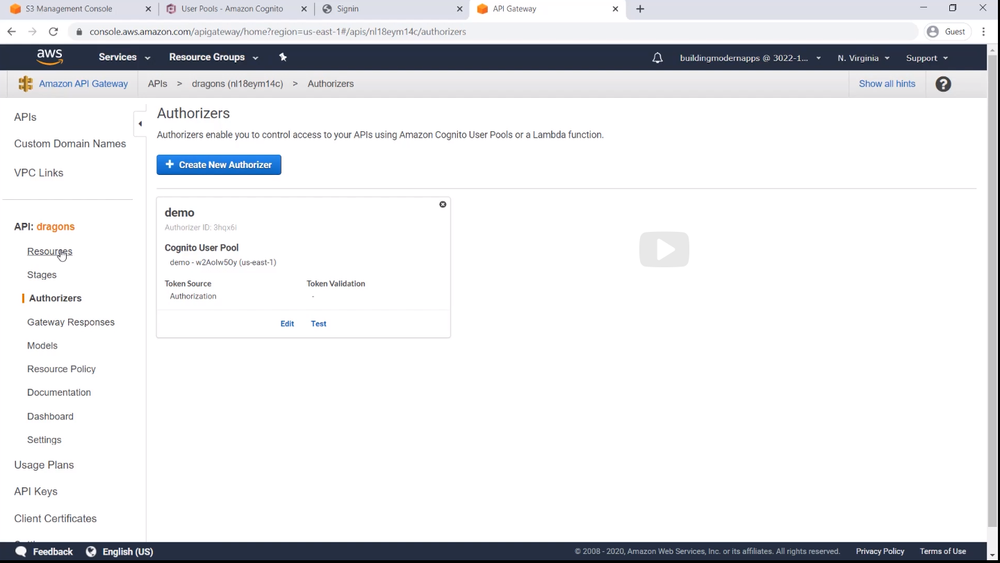
  
click on the GET / dragons.  
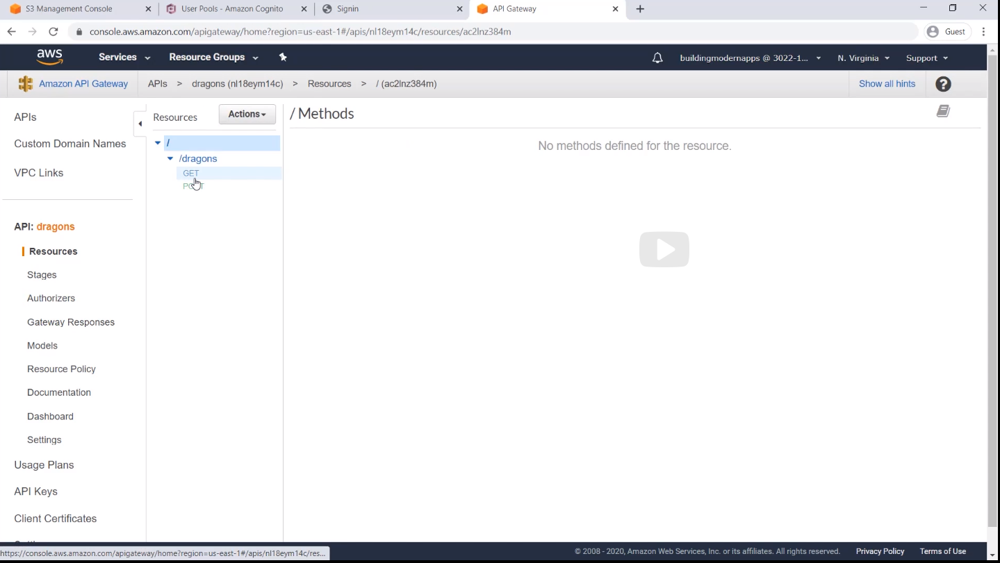
  
On the method requests, I'm gonna modify this authorization  
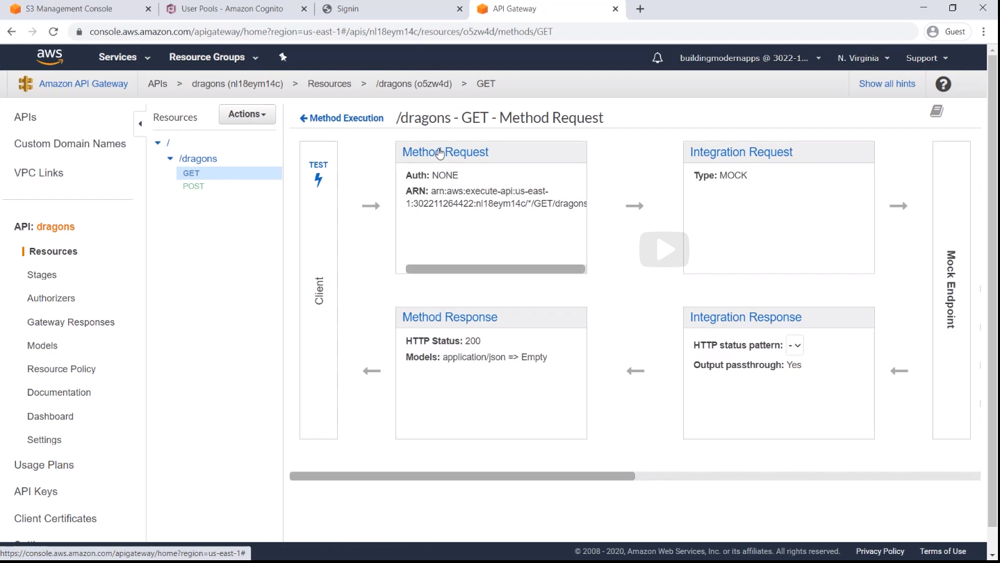
  
and now I'm gonna select my Cognito User Pool demo.  
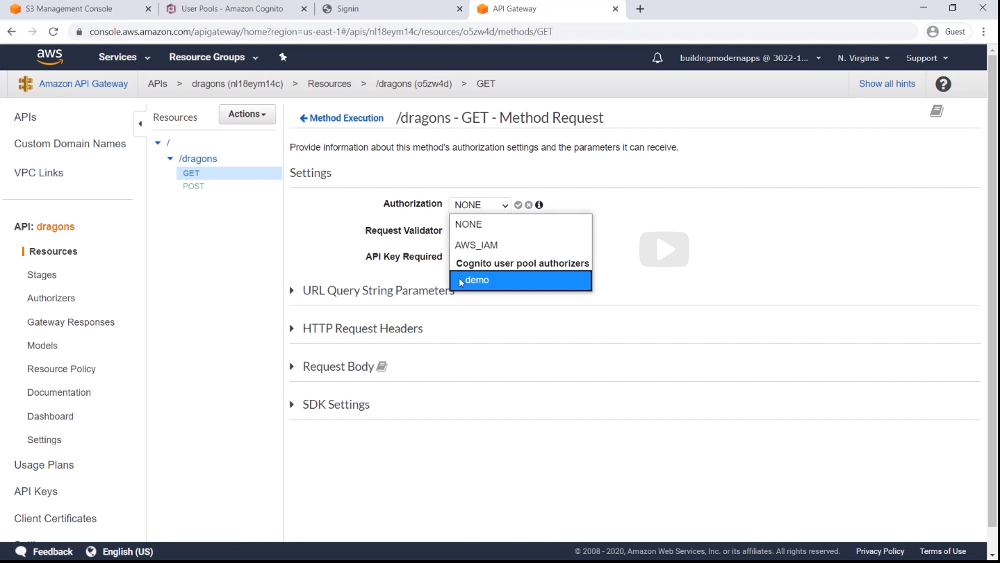
  
Like a little checkmark right here.  
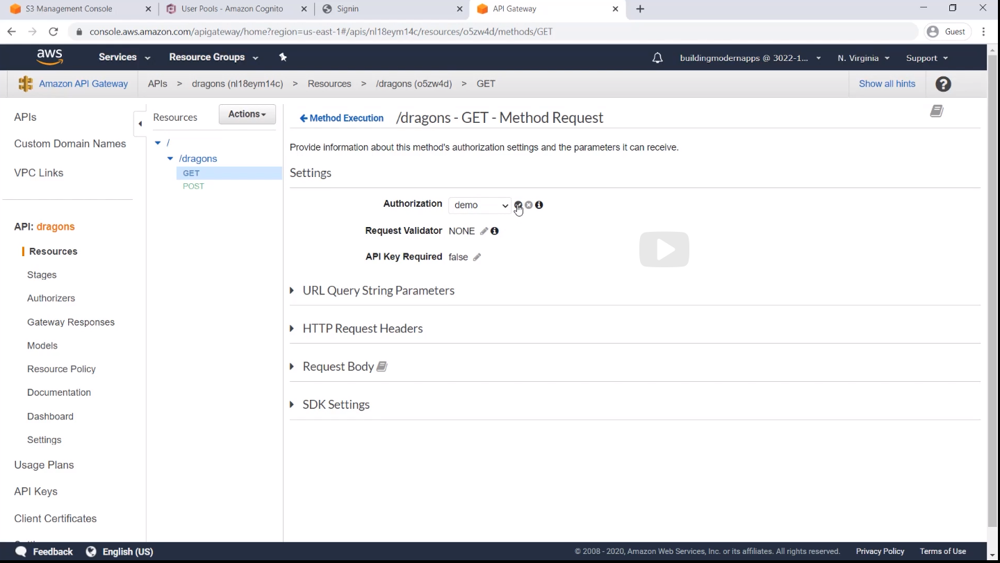
  
So what's my next step? Well, because now I have modified this API, I need to deploy it. So I'm gonna click on Action  
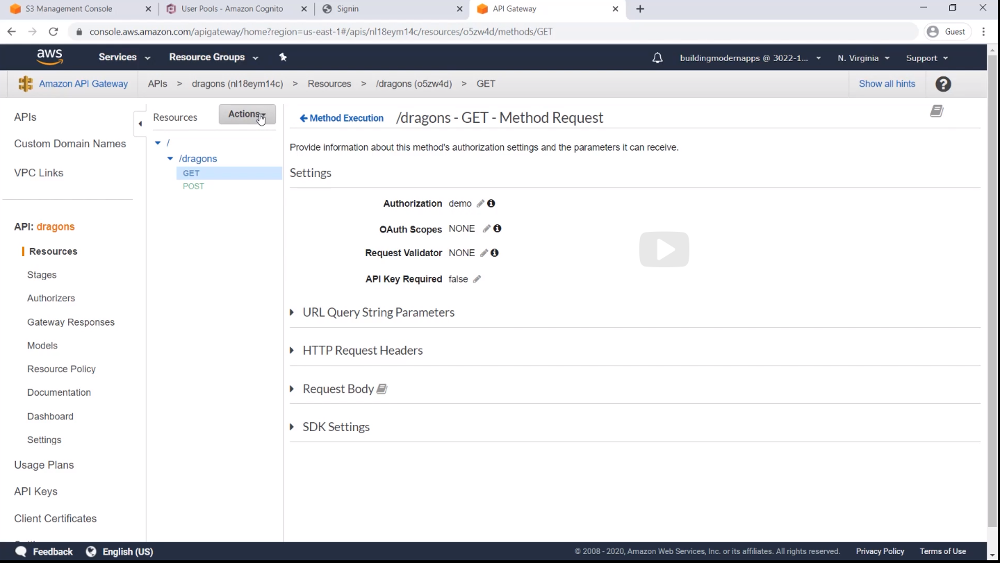
  
Deploy API,  
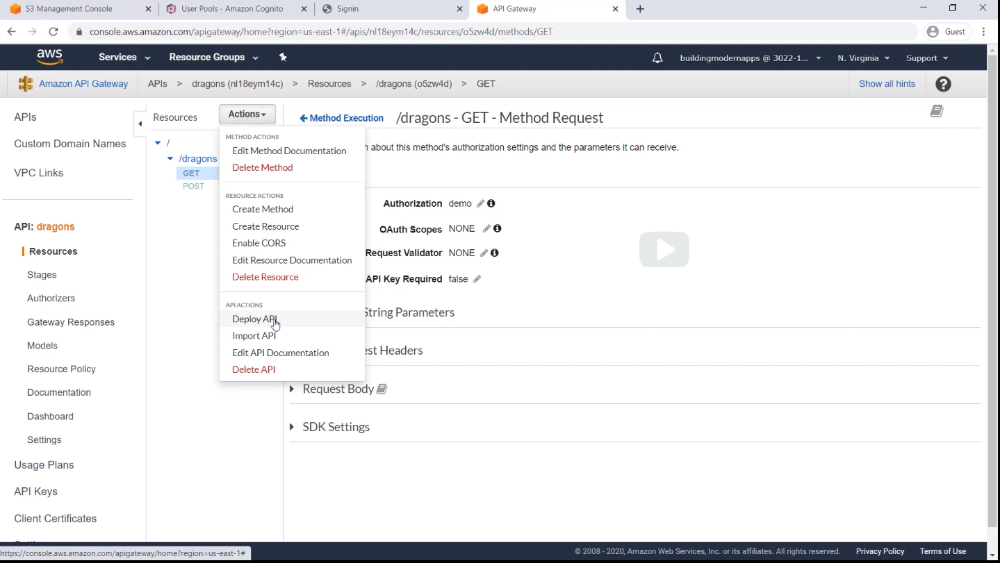
  
and then I'm gonna select the test stage that was created before and hit the deploy button,  
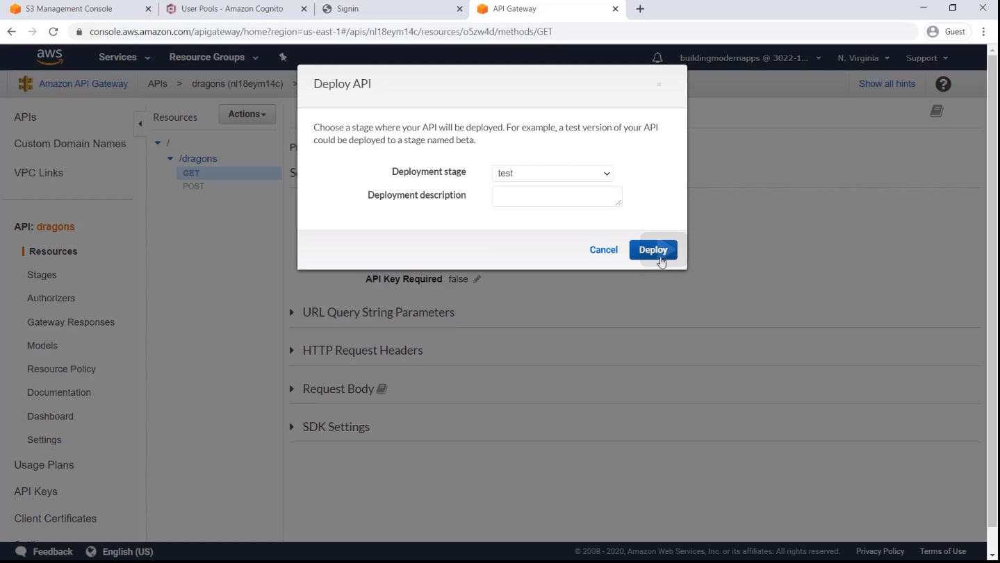
  
and I'm done. So that's it. That's all I needed to do to deploy this entire thing. So it's time to test it.  
But before I do that, I just want to show to you and prove to you that via using Postman without authentication, it's not going to allow me in. So let's test that.   
  
I'm first going to copy this invoke URL that is right here
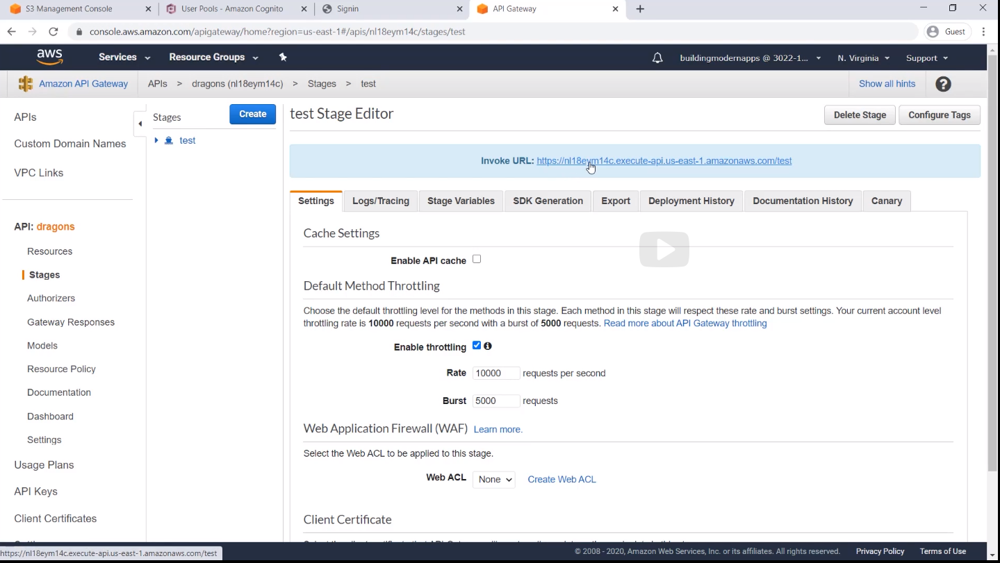
  
and I'm going to go over into Postman. I will create a new request, it's a GET requests to my invoke URL but I'm actually going to / dragons, I'm gonna add that there, and I'm gonna click the send button.  
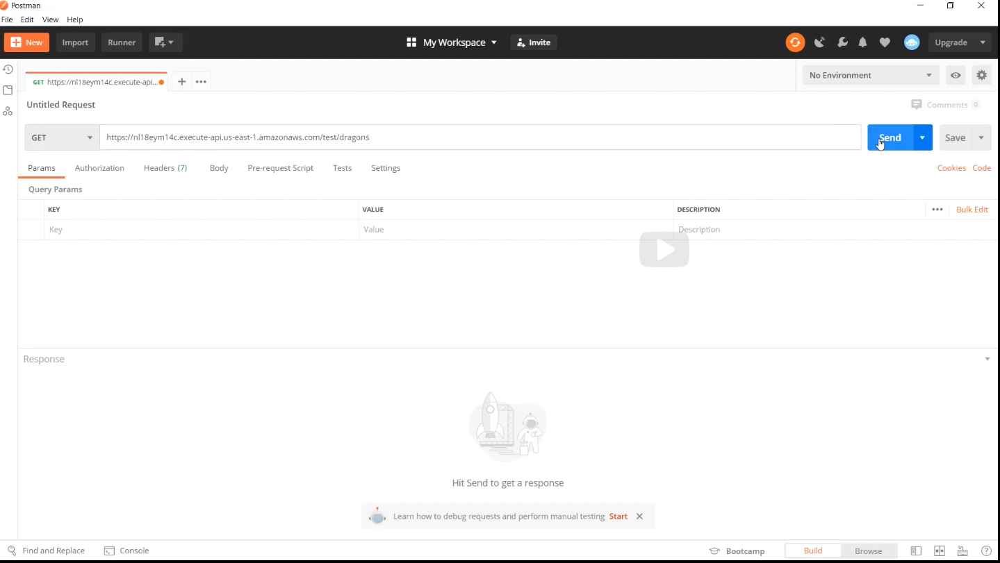
  
Now just look over here. Status 401 unauthorized.  
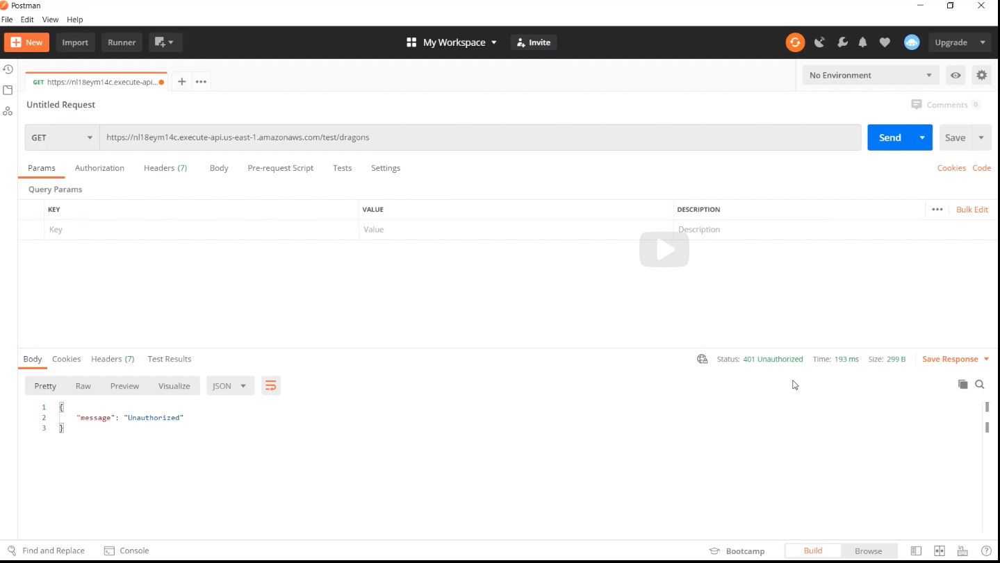
  
What just happened? Well, yeah, I'm not authorized to go in, I don't have access to this API, so I need authorization to be able to do that, so perfect. That's exactly what I wanted.  
  
  
So let me take you through the flow of authentication and authorization that this should be going through with all of these tools
that we have been using so far.   

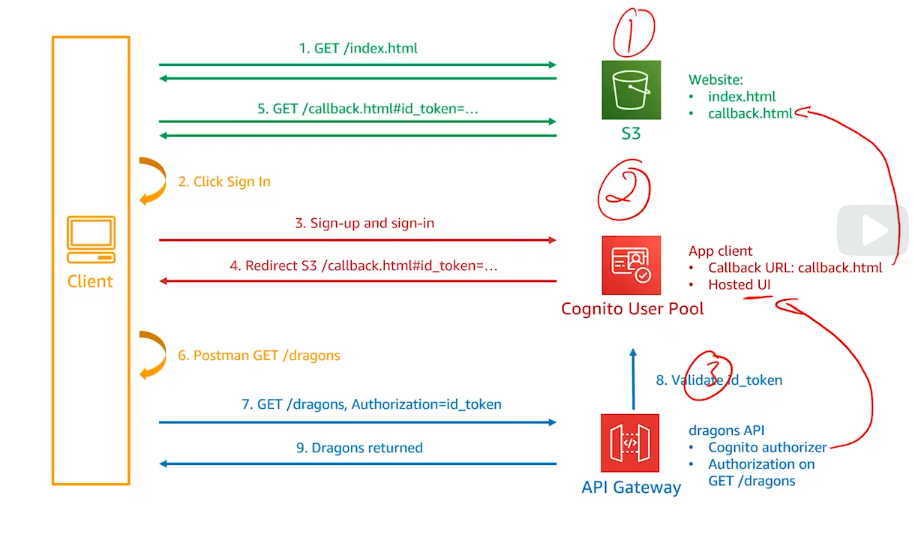
  
First, the client will send a GET requests for the index page inside of S3. Then the client will click the sign in link inside of that page that they received, and that will be sent to the hosted UI in Cognito User Pool. The client will need to sign in or in fact sign up and then sign in, and then once that's done, the hosted UI will send a redirect back to the client, pointing to the website, the S3 website callback.html page with the JWT token inside of it. As you can see inside of this whiteboard here with the ID underscore token. So this is the actual JWT token that we wanna be able to pass back towards that callback page. Then from here, acting as the client, I will take that token and then use Postman to execute a GET / dragon, passing the authorization, and then that will be sent into API Gateway. Then API Gateway will validate that token with Cognito User Pool. And if that's successful, it will return the dragons. 
  
So let's do it together by going over into my console.  
So the first step at the top here is get index. So where's the index in S3, inside of S3. Here's my index file. I'm going to just open up a new tab with that URL  
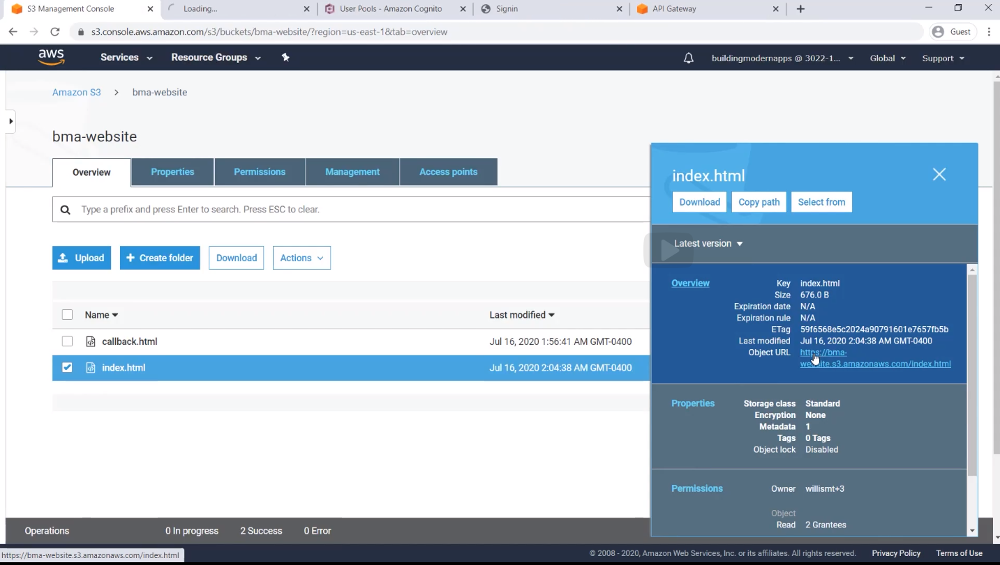
  
and here it is, and here's my signing link, like I told you a little bit earlier. So I'm going to click on sign in  
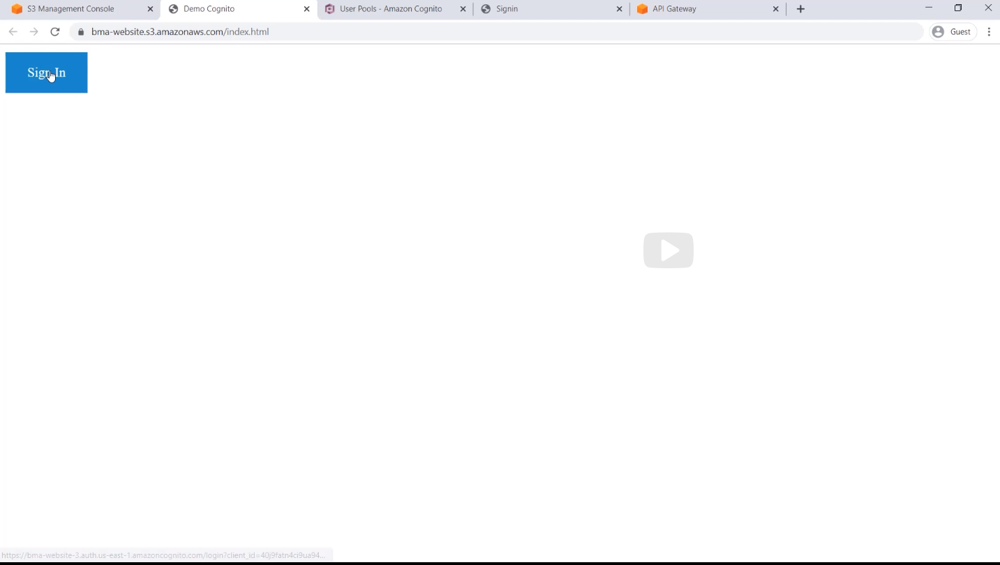
  
and then this is the page that is showing me up here, but I don't have an account yet, so I'll need to sign up. So click on the sign up button  
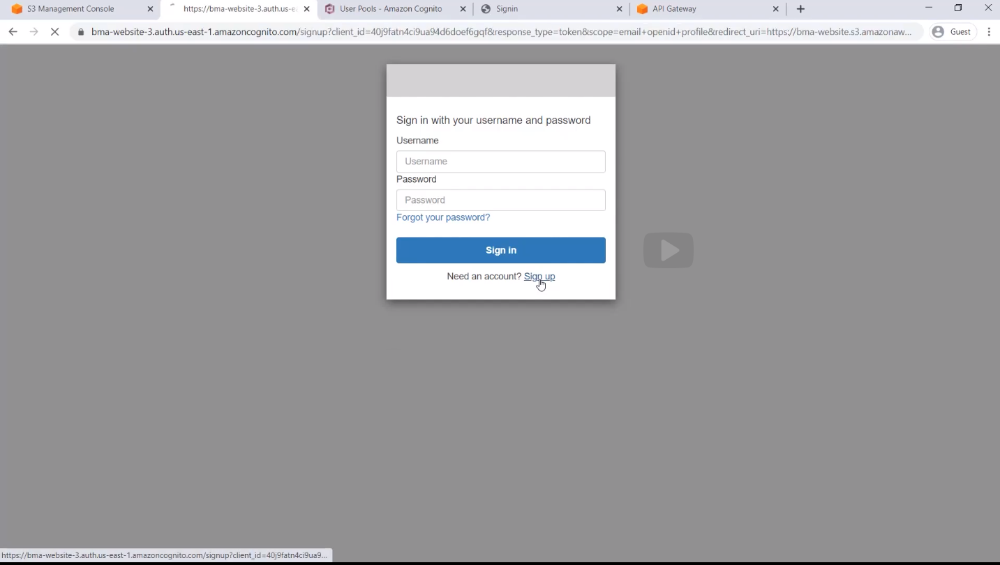
  
I'll give an input a name here, so "John" and I'll input an email address, and then I will input my password, and hit the sign up button  
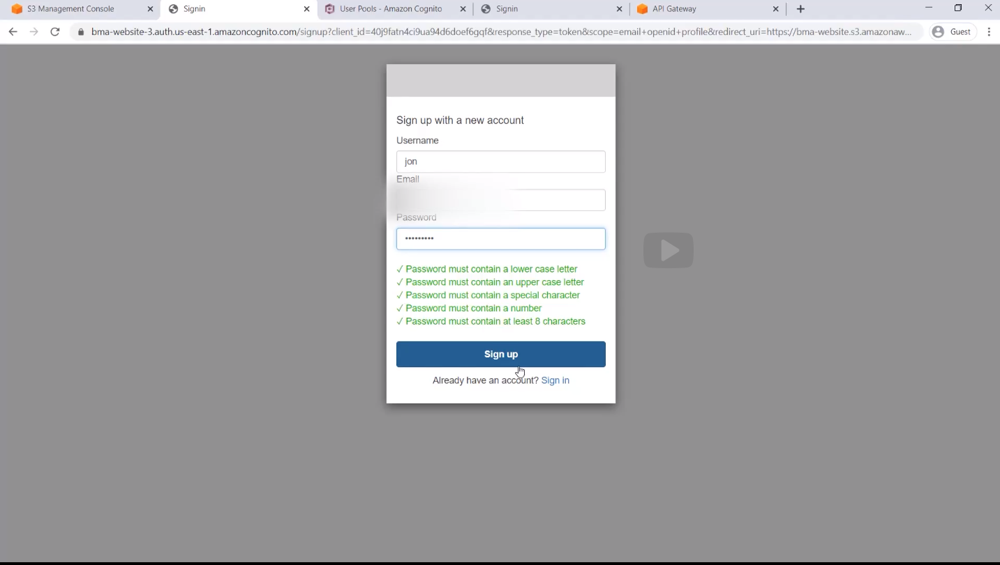
  
and now it needs to validate that I have access to that email that has just arrived. So I'm going to need to wait for this to arrive. Let me go and check in my inbox right now to see if it has arrived. Here is the email. So it says your confirmation code is, and then I have a number. So I will copy this code  
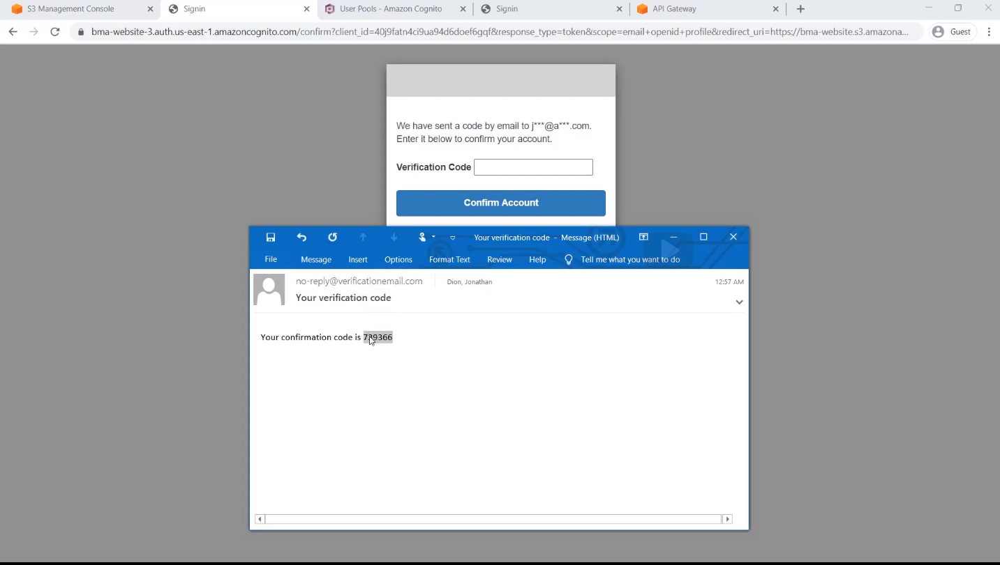
  
and then I'll paste that into my verification code right here and click Confirm Account  
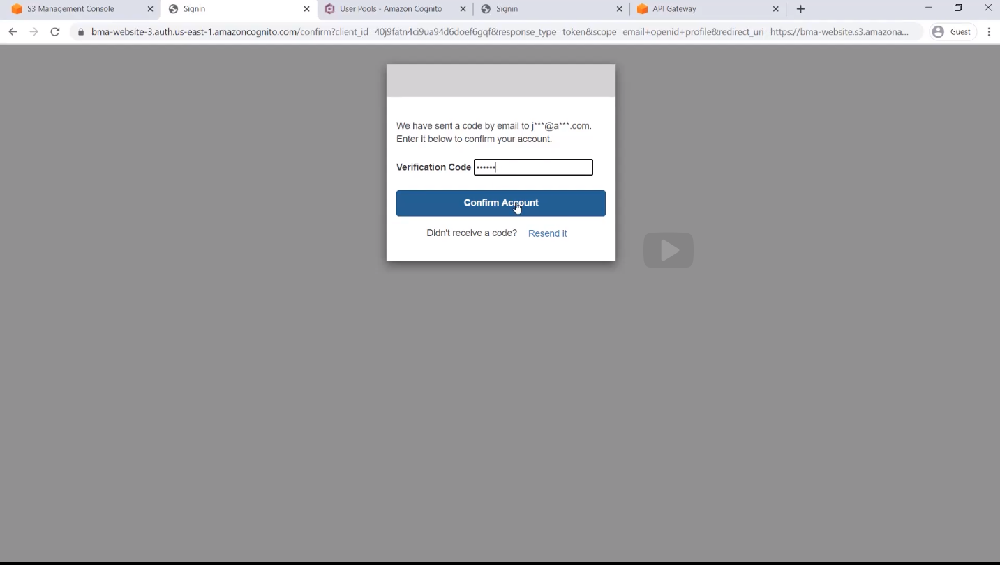
  
and voila, I was redirected back to my callback page HTML with my ID token that I had at the top over there inside of the URL.  
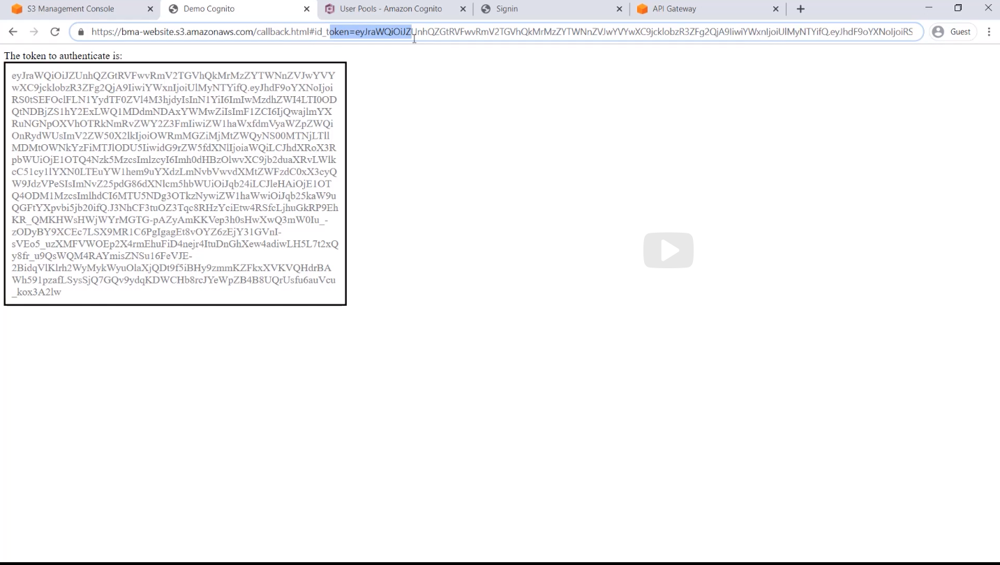
  
What my callback page does is it takes that token from the request and just outputs it back into page here as you can see. Let me show you the code. Again, nothing complex here. I just have some CSS at the top to make that page prettier, and then I just grab that ID token or that JWT token from the URL, and then I just re-output it inside of the page  
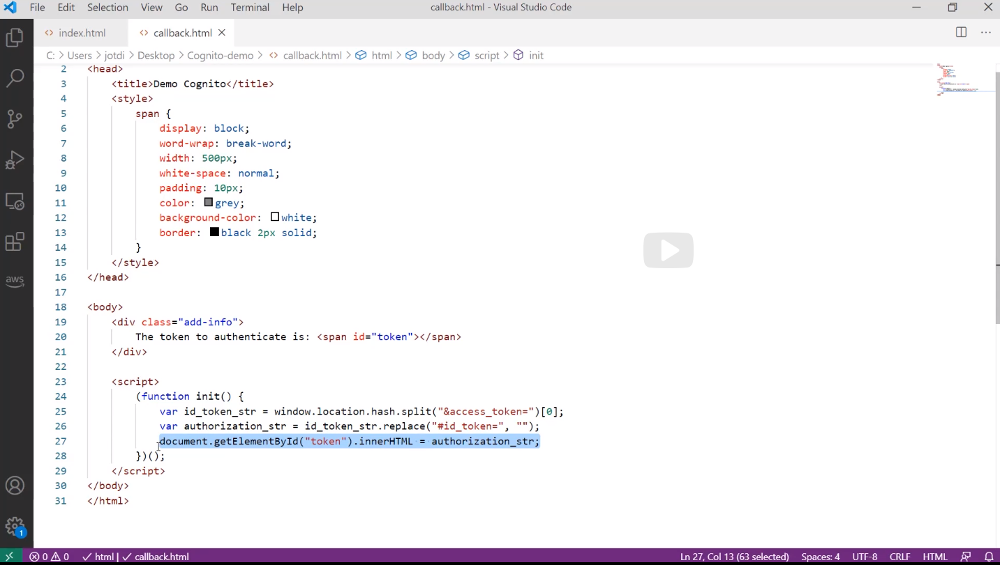
  
so that you can see it, like as you saw it right in there. So I'm going to just take this token now that you can see here. And in that, that's my JWT token. So now I'm going to use this inside of my request via Postman.  
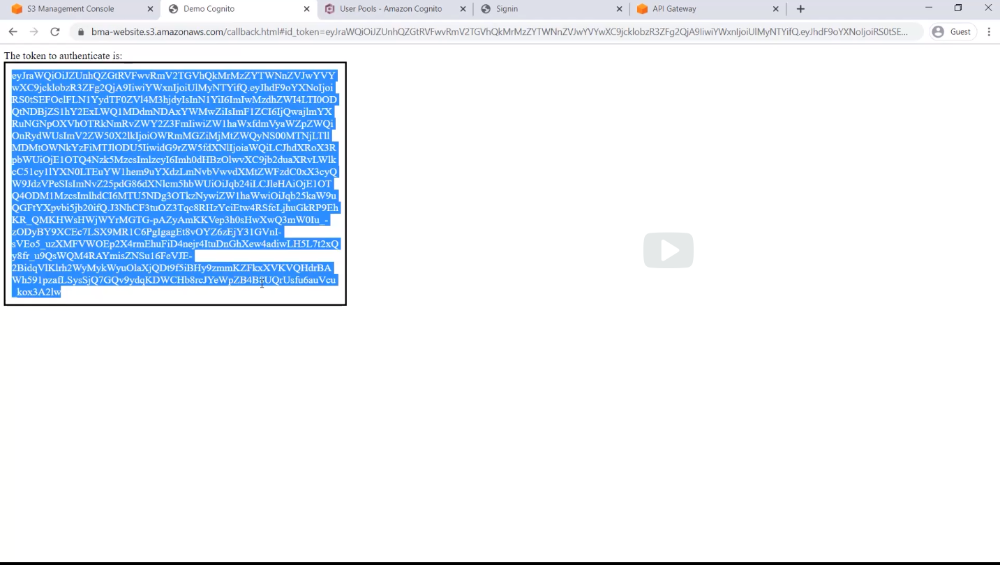
  
If you remember inside of API Gateway in my authorizer  
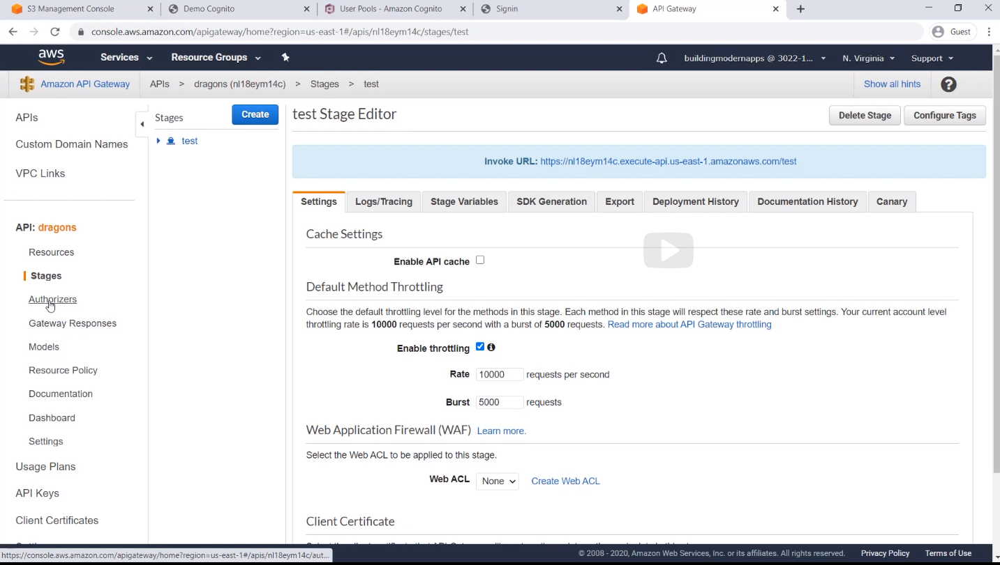
  
I have selected token source as authorization.  
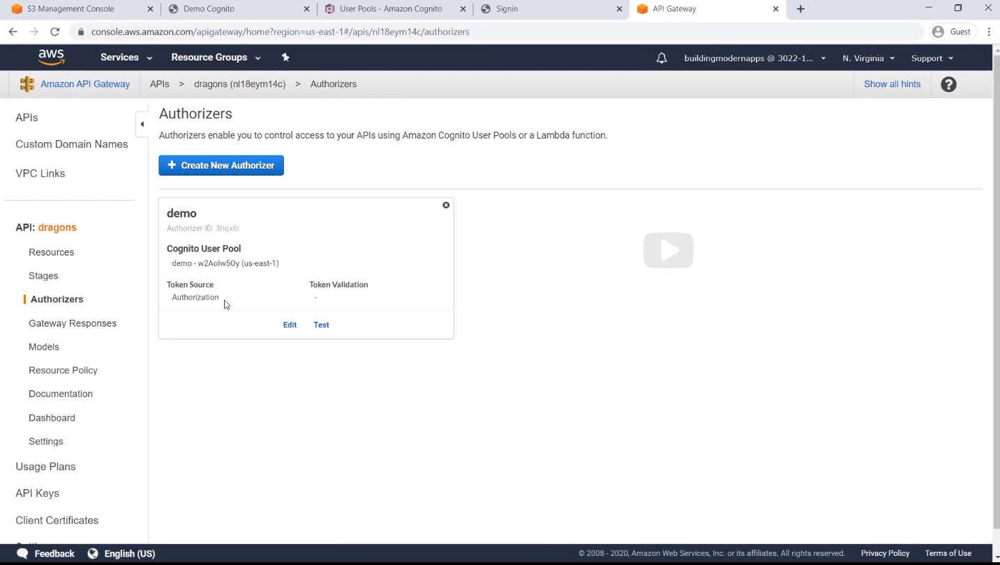
  
That's the name of the header. So I'm gonna need to configure a header called authorization inside of my Postman request. So let me go do that. So inside of Postman, the same request we had a little bit earlier, I'm gonna under headers  
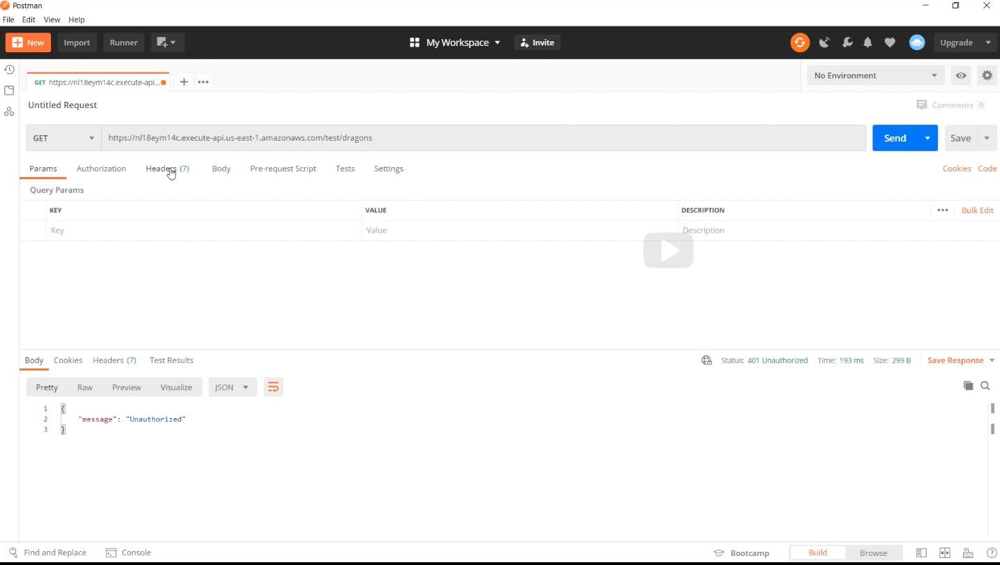
  
add a new key and they called that authorization, there it is, and I'm gonna add a value, which is my token that I copied earlier, right? Very, very, very long token right there. And I'm just gonna hit the send button.  
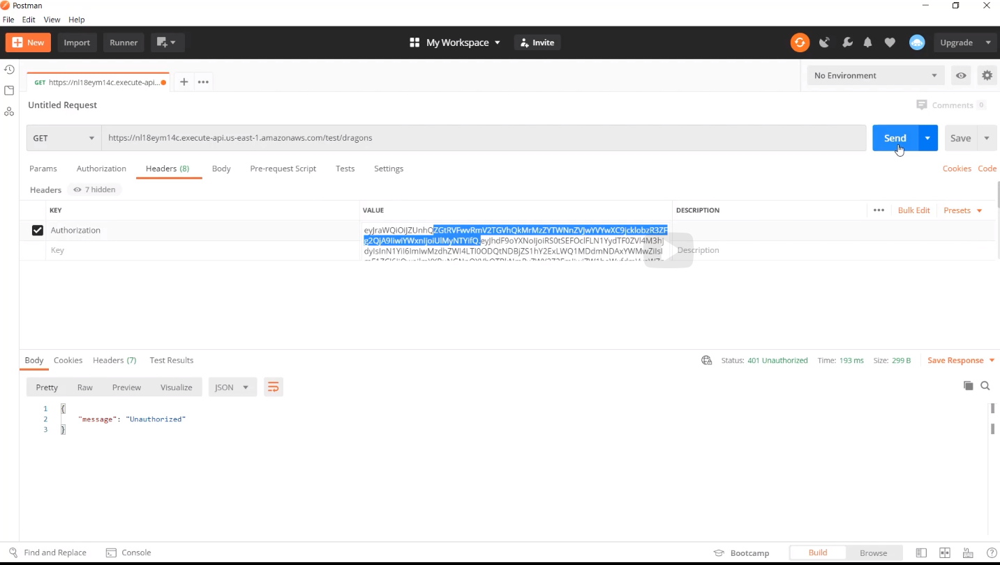
  
And there it is. I received a list of dragons right here at the bottom.  
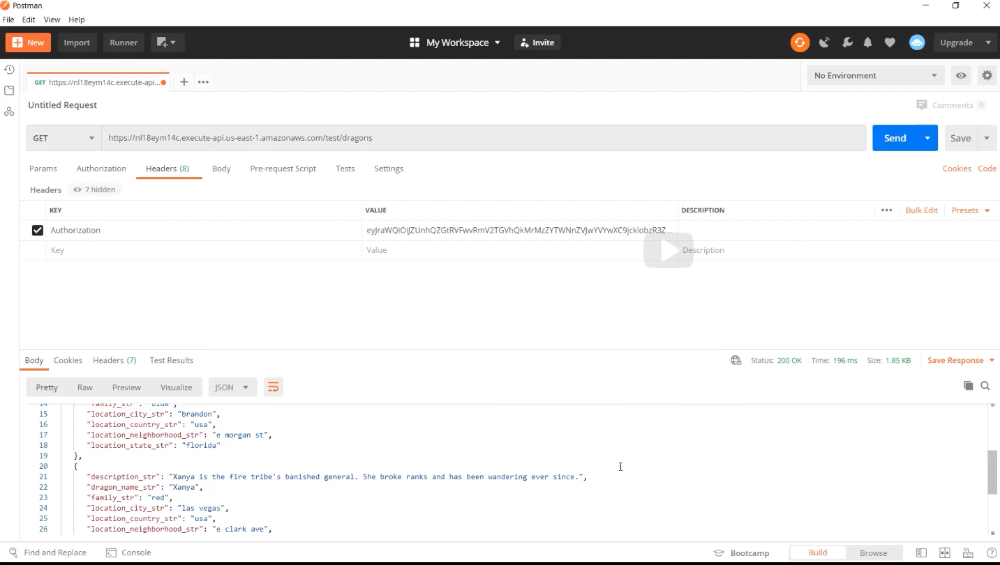
  
We just went through the entire flow of how you authenticate a client's request, an API Gateway using a Cognito User Pool.

<pre>


    
</pre>
## Cognito Notes

### <ins>Authentication for HTTP API</ins>

Amazon API Gateway HTTP API supports JSON Web Tokens (JWTs) as part of OpenID Connect (OIDC: https://openid.net/specs/openid-connect-core-1_0.html) and OAuth 2.0 (https://oauth.net/2/) frameworks to restrict client access to your APIs. Those are open standards which means that API Gateway HTTP API can integrate with many third-party tools. A great resource to learn more about these two can be found at:

https://openid.net/connect/faq/.

It is recommended to make use of Access Token Scopes (https://tools.ietf.org/html/rfc6749#section-3.3) when using JWTs so that you can limit the authorization to your API only to those who have the scope you specified while defining your HTTP API. You can find more information about scopes in HTTP API at: https://docs.aws.amazon.com/apigateway/latest/developerguide/http-api-jwt-authorizer.html.

### <ins>API Gateway resource policy</ins>

Combining API Gateway resource policies with other authorizers affects how they can be used and what you can add to your resource policy. For example, combining a resource policy with IAM as an authorizer means that authentication with IAM will be done first. You can then use the information supplied by IAM in the resource policy. You can find diagrams explaining the authorization flow with any combination of these here:

https://docs.aws.amazon.com/apigateway/latest/developerguide/apigateway-authorization-flow.html

### <ins>Signing AWS requests</ins>

Every request to the APIs of AWS needs to be signed so AWS can identify who sent them. It also allows to protect the data in transit because a signature was created from the request. This means that even if a bad actor was to modify the request in transit from let’s say a “create” to a “delete”, it wouldn’t be accepted by the APIs of AWS as the signature wouldn’t match. It also protects against replay attacks as the requests are only valid for a set period of time. To sign the request, you must use an Access Key and a Secret Key. If you use the AWS Management Console, the CLI or the SDK, this signature is done automatically for you. However, if you prefer to make your own calls to the APIs, which is not recommended, you would need to understand Signature Version 4 process. You can find more information about it here:

https://docs.aws.amazon.com/general/latest/gr/sigv4_signing.html